## 1. Θεωρητικό μέρος

**Ερώτημα α) :**

**Το πρόβλημα** με το οποίο ασχολείται το άρθρο είναι η ανάγκη για ύπαρξη μίας μεθόδου αναπαράστασης των εικόνων, η οποία να επιτρέπει όσο το δυνατόν μικρότερο μέγεθος εικόνας (λιγότερα bits ανά pixel), χωρίς παράλληλα να υποβαθμίζει την ποιότητα της εικόνας.

**Οι βασικές ιδέες** 

Έτσι προτείνεται μία μέθοδος η οποία συνδυάζει στοιχεία από τεχνικές πρόβλεψης και τεχνικές μετασχηματισμού και είναι ιδιαίτερα αποδοτική υπολογιστικά. Η μέθοδος βασίζεται στην ιδέα πως τα γειτονικά pixel μίας εικόνας είναι ισχυρά συσχετισμένα, με αποτέλεσμα την ύπαρξη μεγάλου ποσσοστού πλεονάζουσας πληροφορίας. Για την αποδοτικότερη κωδικοποίηση πρέπει λοιπόν να επιτευχθεί μία αποσυσχέτιση μεταξύ των pixel. Συγκεκριμένα, πραγματοποιείται μία διαδικασία η οποία ισοδυναμεί με ένα βαθυπερατό φιλτράρισμα στην αρχική εικόνα, με χρήση μίας Gaussian-like σταθμισμένης συνάρτησης. Η βαθυπερατή εικόνα που προκύπτει, αφαιρείται από την αρχική εικόνα δίνοντας ως αποτέλεσμα μία εικόνα σφάλματος, της οποίας τα pixel είναι σε μεγάλο βαθμό αποσυσχετισμένα, και άρα αυτή παρουσιάζει χαμηλή εντροπία και variance. Αυτό μας επιτρέπει να αναπαραστήσουμε την εικόνα σφάλματος με χρήση λιγότερων bits ανά pixel ενώ μπορούμε να πραγματοποιήσουμε επιπλέον κβαντισμό σε αυτή χωρίς να προκύψουν σημαντικά σφάλματα. Παράλληλα, η βαθυπερατή εικόνα πορεί να υποδειγματοληπτηθεί χωρίς την εμφάνιση φαινομένων aliasing. 

Η διαδικασία αυτή επαναλαμβάνεται σε πολλαπλά επίπεδα, εκτελώντας κάθε φορά βαθυπερατό φιτλράρισμα της βαθυπερατής εικόνας του προηγούμενου επιπέδου και λαμβάνοντας την διαφορά αυτής μείον την προκύπτουσα βαθυπερατή εικόνα. Το αποτέλεσμα είναι τελικά ένα σύνολο επιπέδων βαθυπερατών εικόνων καθώς και ένα σύνολο επιπέδων εικόνων σφάλματος. Καθώς δε η κάθε βαθυπερατή εικόνα υποδειγματοληπτείται, κάθε επίπεδο έχει διαστάσεις μικρότερες του προηγουμένου (μειωμένες στο μισό για μείωση της συχνότητας δειγματοληψίας στην μέση) και τελικά τα επίπεδα βαθυπερατών εικόνων και εικόνων διαφοράς σχηματίζουν δύο "πυραμίδες", ονομαζόμενες η πρώτη Gaussian και η δεύτερη Laplacian. Η μέθοδος αυτή, έχει σημάντικα αποτελέσματα τελικά, αφού μπορεί να δειχθεί πως μπορούμε να ανακατασευάσουμε την αρχική εικόνα μόνο με χρήση της Laplacian πυραμίδας και επομένως χρειάζεται να αποθηκεύσουμε μόνο αυτήν. Αν δε αναλογιστούμε πως αυτή, όπως αναφέρθηκε, μπορεί να κβαντιστεί ισχυρά με μικρή μόνο μείωση της τελικής ποιότητας εικόνας, τα οφέλη της μεθόδου είναι προφανή.


**Ερώτημα β) :**

Ο σκοπός του φίλτρου Gauss είναι να μειώσει την μέγιστη συχντότητα μίας εικόνας (βαθυπερατό φιλτράρισμα) προκειμένου να επιτρέψει την υποδειγματοληψία της προκύπτουσας εικόνας χωρίς την εμφάνιση φαινομένων aliasing. Το γκαουσιανό φιλτράρισμα πραγματοποιεί ουσιαστικά ένα είδος smoothing στην εικόνα, με αποτέλεσμα απότομες αλλαγές που δεν θα μπορούσαν να αποτυπωθούν σωστά στην εικόνα που θα προκύψει στο επόμενο στάδιο της δειγματοληψίας να γίνονται λιγότερο απότομες. 

Αν χρησιμοποιούσαμε μόνο υποδειγματοληψία και όχι και smoothing τοτε είναι πιθανό να είχαμε προβλήματα αναδίπλωσης, δηλαδή να μην μπορούσαμε να ανιχνεύσουμε τις απότομες αλλαγές σε σημεία της εικόνας και άρα η τελική εικόνα να διέφερε κατά πολύ από την αρχική. Ειδικά στις gaussian pyramids που σε κάθε επίπεδο η πυκνότητα των δειγμάτων είναι πιο αραιή από το προηγούμενο τότε η υποδειγματοληψία θα είχε καταστροφικές συνέπειες στην ποιότητα της εικόνας. 

**Ερώτημα γ) :**

Με την πυραμίδα Gauss ουσιαστικά αποθηκεύουμε τις βαθυπερατές και υποδειγματοληπτημένες εικόνες σε πολλαπλές κλίμακες ενώ αντίθετα, η πυραμίδα Laplacian αποθηκεύει την διαφορά ανάμεσα σε δύο διαδοχικά επίπεδα της πυραμίδας Gauss.

Η διαφορά αυτή είναι ουσιαστικά μία “error image” (εικόνα σφάλματος) και έχει το χαρακτηριστικό ότι η συσχέτιση που εμφανίζει από pixel σε pixel είναι πολύ χαμηλότερη απ’ ότι στην αρχική ή στην gaussian εικόνα, το οποίο οδηγεί σε μία συγκέντρωση των τιμών των pixel γύρω από το μηδέν (με αποτέλεσμα χαμηλότερη εντροπία και variance). Έτσι, μπορούμε τελικά να χρησιμοποιήσουμε λιγότερα bits για την αναπαράσταση της εικόνας, ενώ μπορούμε παράλληλα να πραγματοποιήσουμε κβαντισμό στα επίπεδα της Λαπλασιανής πυραμίδας μειώνοντας την εντροπία και τα bits ανά pixel περαιτέρω, χωρίς σημαντική υποβάθμιση της ποιότητας της ανακατασκευασμένης εικόνας.

**Ερώτημα δ) :**

Εφόσον δεν έχει υπάρξει κβαντισμός ο οποίος θα εισήγαγε κάποια σφάλματα, μπορούμε από την πυραμίδα Laplacian δηλαδή από τις διαφορές των εικόνων για τα επίπεδα 1,2,..Ν-1 και την βαθυπερατή εικόνα επιπέδου Ν, να ανακτήσουμε τέλεια την αρχική εικόνα. Για τον σκοπό αυτό εκτελούμε μία διαδικασία η οποία στο άρθρο αναφέρεται ως EXPAND, κατά την οποία παρεμβάλλονται νέες τιμές στις ήδη υπάρχουσες τιμές της εικόνας με στόχο τον διπλασιασμό των διαστάσεων της προκειμένου να έχει τις ίδιες διαστάσεις με την αρχική εικόνα. Έτσι, ξεκινώντας από το επίπεδο Ν, πραγματοποιούμε στην Laplacian εικόνα expand και στην συνέχεια την προσθέτουμε με την εικόνα του επιπέδου Ν-1. Αντίστοιχα στην συνέχεια πραγματοποιούμε EXPAND στο αποτέλεσμα και ύστερα το προσθέτουμε στην Laplacian εικόνα του Ν-2 επιπέδου κ.ο.κ μέχρι να φτάσουμε τελικά στο επίπεδο 0 όπου και έχουμε την ανακατασκευασμένη αρχική εικόνα. 
Αξίζει να σημειωθεί ότι αντί της μεθόδου αυτής μπορούμε, σύμφωνα με το άρθρο, να πραγματοποιήσουμε στις Laplacian εικόνες EXPAND τόσες φορές ώστε να αποκτήσουν τις διαστάσεις της αρχικής εικόνας και στην συνέχεια να προσθέσουμε όλα τα αποτελέσματα, αυτή η μέθοδος ωστόσο είναι πιο ακριβή υπολογιστικά και δεν προτιμάται. 

## 2. Εργαστηριακό μέρος

## Μέρος Α : Υλοποίηση αλγορίθμου

In [ ]:
import urllib.request
import cv2
import scipy
import skimage
from skimage import data
from scipy.signal import convolve2d
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

Φόρτωση των εικόνων Lena, Camera:

In [ ]:
#fetch Lena image
HTTP_response = urllib.request.urlopen('http://www.image.ntua.gr/~tpar/LABimage/lena.png')

In [ ]:
arr = np.asarray(bytearray(HTTP_response.read()), dtype=np.uint8)
BGR = cv2.imdecode(arr,-1)

Text(0.5, 1.0, 'Lena, grayscale')

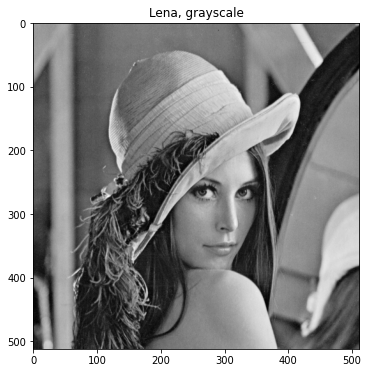

In [ ]:
#convert to gray
Lena_gray = cv2.cvtColor(BGR, cv2.COLOR_BGR2YCrCb)[:,:,0]
plt.figure(figsize=(6, 6))
plt.imshow(Lena_gray, cmap="gray")
plt.title('Lena, grayscale')

Text(0.5, 1.0, 'Lena, RGB')

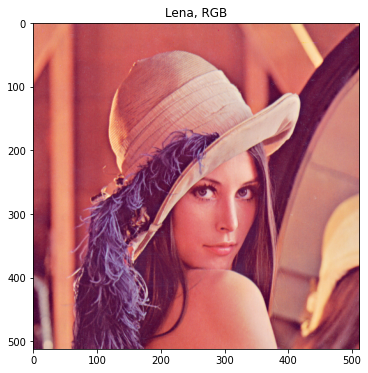

In [ ]:
#keep with color, convert to RGB
Lena_RGB = cv2.cvtColor(BGR, cv2.COLOR_BGR2RGB)
plt.figure(figsize=(6, 6))
plt.imshow(Lena_RGB)
plt.title('Lena, RGB')

Text(0.5, 1.0, 'Camera, grayscale')

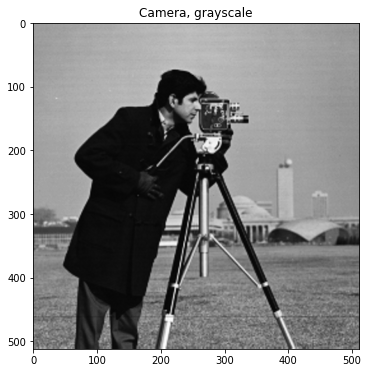

In [ ]:
Camera=skimage.data.camera()
#BGR = cv2.imdecode(cam,-1)
#Camera = cv2.cvtColor(cam, cv2.COLOR_BGR2YCrCb)[:,:,0]
plt.figure(figsize=(6, 6))
plt.imshow(Camera, cmap="gray")
plt.title('Camera, grayscale')

Βοηθητική συνάρτηση:

In [ ]:
#helper function for printing a pyramid
def showPyramid(pyramid, case):
    if (case=='gray'):                                                                        #grayscale image
        f, ax = plt.subplots(1, len(pyramid), figsize=(20, 20))  
        for i in range (0,len(pyramid)):
            ax[i].imshow(pyramid[i], cmap="gray") # Base of the pyramid
            ax[i].set_title('Level {}'.format(i), fontsize=14)
    else:
        f, ax = plt.subplots(1, len(pyramid), figsize=(20, 20))                               #image with color
        for i in range (0,len(pyramid)):
            ax[i].imshow(pyramid[i].astype(int)) # Base of the pyramid
            ax[i].set_title('Level {}'.format(i), fontsize=14)

**Ερώτημα α):**

In [ ]:
def GKernel(a):
  w = np.array([0.25 - a/2.0, 0.25, a, 0.25, 0.25 - a/2.0])                                   #1D kernel
  return w*w.reshape(-1,1)                                                                    #2D kernel

**Ερώτημα β):**

In [ ]:
def GREDUCE(I,h):
  reduced_downsampled = None
  low_pass_image = cv2.filter2D(I,-1,h)                                                        #convolve image with generating kernel
  reduced_downsampled = low_pass_image[::2,::2]                                                #downsample lowpass image (sampling rate reduced in half)
  return reduced_downsampled

**Ερώτημα γ):**

In [ ]:
def GPyramid(I,a,depth):
  pyramid = [I]
  kernel = GKernel(0.4)
  for i in range(0,depth-1):
    gaussian_image = GREDUCE(pyramid[i],kernel)                                               #apply GREDUCE to image of previous level to get lowpass image of next level
    pyramid.append(gaussian_image)
  return pyramid

**Ερώτημα δ):**

In [ ]:
def GEXPAND(I,h):
  expanded_image = None
  if (len(I.shape)==2):                                                                       #grayscale image
    tmp_image = np.zeros((I.shape[0]*2, I.shape[1]*2), dtype=np.float64)                      #obtain an array with every other pixel same as initial image, the rest of the pixels zero,
    tmp_image[::2,::2]=I                                                                      #will be used later for the interpolation of new node values between given values
  else:                                                                                       #image with color
    tmp_image = np.zeros((I.shape[0]*2, I.shape[1]*2, I.shape[2]), dtype=np.float64)
    tmp_image[::2,::2,:]=I
    expanded_image=np.zeros((I.shape[0]*2, I.shape[1]*2, I.shape[2]), dtype=np.float64)
  expanded_image = 4*cv2.filter2D(tmp_image,-1,h)                                             #equation (2) of paper
  return expanded_image

#### **Ερώτημα ε):**

In [ ]:
def LPyramid(I,a,depth):
  gaussian_pyramid = GPyramid(I,a,depth)
  laplacian_pyramid = []
  kernel = GKernel(a)                                                                       #obtain generating kernel for the given value of a
  for i in range(0,depth-1):
    gaussian_image = gaussian_pyramid[i]
    expanded_gaussian_image = GEXPAND(gaussian_pyramid[i+1],kernel)                         #EXPAND image of each level to get the same dimensions as the previous level
    laplacian_pyramid.append(gaussian_image - expanded_gaussian_image+128)                  #get difference of images, add 128 so that we obtain only positive values (center around 128, not zero, this will be substracted 
                                                                                            #during deconstruction so it does not affect results, needed for prinintg the image)
  laplacian_pyramid.append(gaussian_pyramid[depth-1])
  return laplacian_pyramid

**Ερώτημα στ):**

In [ ]:
def L_Pyramid_Decode(L,a):
    kernel = GKernel(a)
    sum_image=L[len(L)-1]
    for i in range(len(L)-2, -1, -1):
        expanded_image = GEXPAND(sum_image,kernel)                                          #expand image to obtain dimensions same as the previous level
        sum_image=L[i]+expanded_image-128                                                   #sum previous level to the sum image calculated so far
    return sum_image                             

**Ερώτημα ε):**

In [ ]:
def L_Quantization(L,bins):                                                                 #Input parameters: the image to be quantized and the number of bins
    if (len(L.shape)==2):                                                                   #grayscale image
        C=np.zeros((L.shape[0], L.shape[1]), dtype=np.float64)
        max_val=L.max()
        n=256/bins                                                                          #maximum value is 255 (so 256 integer values: 0...255), calculate bin size for n bins
        for i in range (0,L.shape[0]):                                                      #for each pixel
            for j in range(0,L.shape[1]):
                for m in range(0,bins):
                    if (L[i][j]<=(m+1/2)*n and L[i][j]>=(m-1/2)*n):                         #equation (5) of paper
                        C[i][j]=m*n
    else:                                                                                   #image with color
        C=np.zeros((L.shape[0], L.shape[1],L.shape[2]), dtype=np.float64)
        max_val=L.max()
        n=255/bins                                                                          #maximum value is 255, calculate bin size for n bins
        for i in range (0,L.shape[0]):                                                      #for each pixel
            for j in range(0,L.shape[1]):
                for k in range(0,L.shape[2]):
                    for m in range(0,bins):
                        if (L[i][j][k]<=(m+1/2)*n and L[i][j][k]>=(m-1/2)*n):               #equation (5) of paper
                            C[i][j][k]=m*n
    return C

## Μέρος Β : Δοκιμές αλγορίθμου

Παρουσιάζουμε αρχικά τις προκύπτουσες Gaussian πυραμίδες, για τις εικόνες Lena (grayscale, RGB), και Camera:

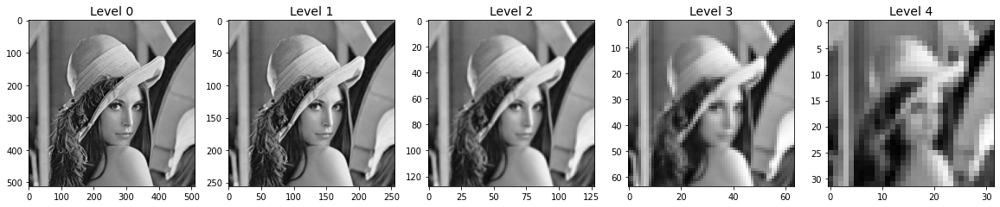

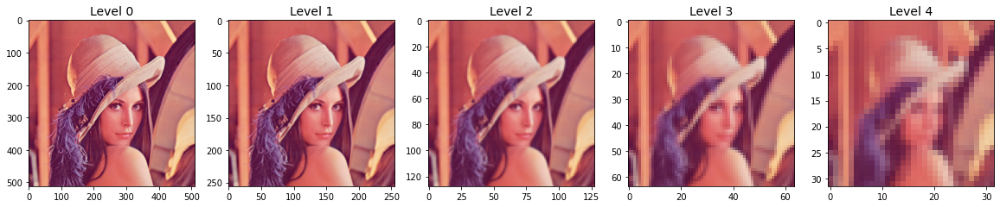

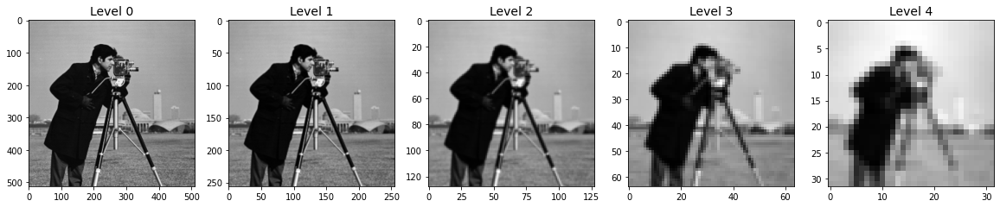

In [ ]:
#calculate and print gaussian pyramid for each image 

#Lena grayscale
Lena_gray_gaus=GPyramid(Lena_gray,0.4,5)
#print(len(Lena_gray_gaus))
showPyramid(Lena_gray_gaus,'gray')

#Lena RGB

Lena_RGB_gaus=GPyramid(Lena_RGB,0.4,5)
showPyramid(Lena_RGB_gaus,'gray')

#Camera

Camera_gaus=GPyramid(Camera,0.4,5)
showPyramid(Camera_gaus,'gray')

Παρατηρούμε ότι κάθε επίπεδο είναι μια πιο "smoothed" έκδοση του προηγούμενού του, το οποίο είναι αναμενόμενο δεδομένου ότι αποτελεί ένα βαθυπερατό τμήμα του προηγούμενου επιπέδου. Όσο προχωράμε σε επόμενα επίπεδα η εικόνα γίνεται πιο θολή (λιγότερο crisp).

**Ερώτημα α):**

Παρουσιάζουμε τις προκύπτουσες Laplacian πυραμίδες, με χρήση της συνάρτησης L_Pyramid:

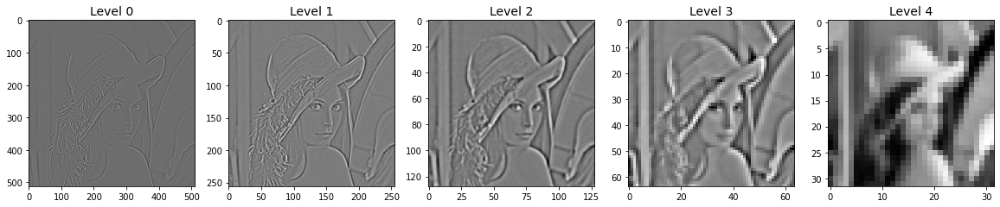

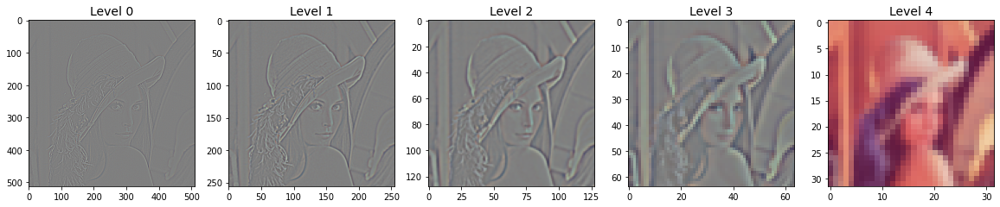

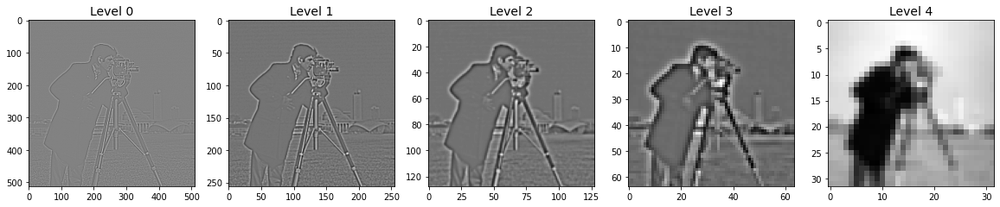

In [ ]:
#Laplacian Pyramid

#Lena grayscale
Lena_gray_lap=LPyramid(Lena_gray,3/8,5)
showPyramid(Lena_gray_lap, 'gray')

#Lena RGB

Lena_RGB_lap=LPyramid(Lena_RGB,3/8,5)
showPyramid(Lena_RGB_lap,'RGB')

#Camera

Camera_lap=LPyramid(Camera,3/8,5)
showPyramid(Camera_lap,'gray')

Παρατηρούμε ότι στις εικόνες της Laplacian πυραμίδας εμφανίζονται έντονα οι λεπτομέρειες τις εικόνες όπως για παράδειγμα οι ακμές αυτής. Οι πιο fine λεπτομέρειες είναι ορατές σε χαμηλότερα επίπεδα, ενώ όσο προχωράμε σε επόμενα επίπεδα βλέπουμε πιο coarse χαρακτηρηστικά. Αυτό είναι λογικό, αφού ουσιαστικά κάθε επίπεδο προκύπτει ως η λεπτομέρεια μιας εικόνας με όλο και πιο βαθυπερατό φάσμα στην Gaussian πυραμίδα.

Στην συνέχεια παρουσιάζουμε την ανακατασευασμένη από την Laplacian πυραμίδα εικόνα με χρήση της  L_Pyramid_Decode, καθώς και την αρχική εικόνα, χάριν σύγκρισης:

Text(0.5, 1.0, 'Original')

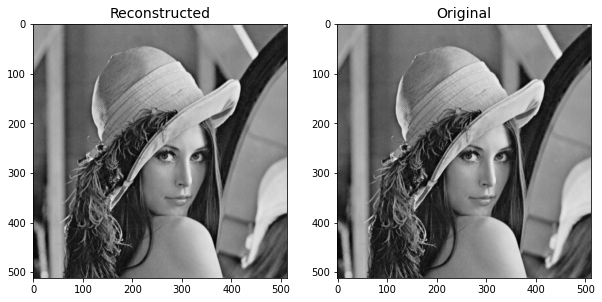

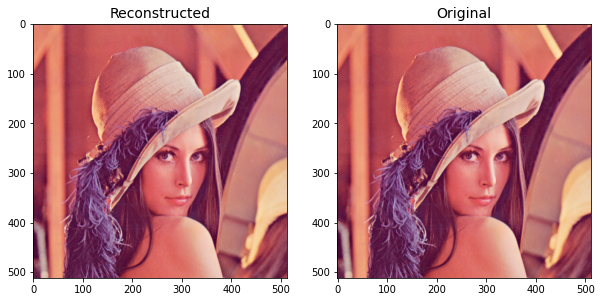

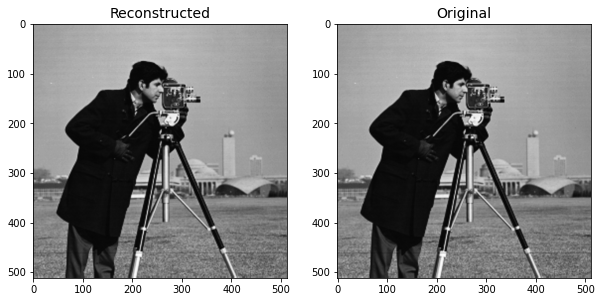

In [ ]:
#Plot reconstructed images 

#Lena grayscale
Lena_gray_dec=L_Pyramid_Decode(Lena_gray_lap,3/8)
f1, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))

ax0.imshow(Lena_gray_dec, cmap="gray")
ax0.set_title('Reconstructed', fontsize=14)
ax1.imshow(Lena_gray, cmap="gray")
ax1.set_title('Original', fontsize=14)

#Lena RGB

Lena_RGB_dec=L_Pyramid_Decode(Lena_RGB_lap,3/8)
f2, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
ax0.imshow(Lena_RGB_dec.astype(int), cmap="gray")
ax0.set_title('Reconstructed', fontsize=14)
ax1.imshow(Lena_RGB, cmap="gray")
ax1.set_title('Original', fontsize=14)

#Camera

Camera_dec=L_Pyramid_Decode(Camera_lap,3/8)
f3, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
ax0.imshow(Camera_dec, cmap="gray")
ax0.set_title('Reconstructed', fontsize=14)
ax1.imshow(Camera, cmap="gray")
ax1.set_title('Original', fontsize=14)


In [ ]:
# Check if the reconstruction is lossless

print('Is reconstruction exact for Lena grayscale?', (Lena_gray==Lena_gray_dec).all())
print('Is reconstruction exact for Lena RGB?',(Lena_RGB==Lena_RGB_dec).all())
print('Is reconstruction exact for Camera?',(Camera==Camera_dec).all())

Is reconstruction exact for Lena grayscale? True
Is reconstruction exact for Lena RGB? True
Is reconstruction exact for Camera? True


Με βάση τον παραπάνω έλεγχο μέσω αλλά και το οπτικό αποτέλεσμα, παρατηρούμε ότι η ανακατασκευή της εικόνας από την Laplacian πυραμίδα γίνεται χωρίς απώλειες, κάτι το οποίο είναι αναμενόμενο σύμφωνα με την θεωρητική ανάλυση. (Προϋπόθεση ότι χρησισμοποιούμε κατά την κωδικοποίηση και κατά την αποκωδικοποίηση την ίδια τιμή για την παράμετρο a, στην παρούσα περίπτωση ίση με 3/8, ώστε να έχουμε το ίδιο generating kernel).

**Ερώτημα β):**

Εμφανίζουμε αρχικά την Λαπλασιανή πυραμίδα για μεταβλητό a στο διάστημα [0.2,...0.7]. Επιλέξαμε να χρησιμοποιήσαμε τιμές του αναφερθέντος διαστήματος με step 0.1 και να παρουσιάσουμε πυραμίδες πέντε επιπέδων (depth=5). Εμφανίζουμε επίσης την αρχική εικόνα, χάριν σύγκρισης.

In [ ]:
#a function to show the pyramid for different values of a 
def showLaplacianForValuesOfa(I_original):                                          
    for a in range (2,8):
        a=a/10
        pyramid=LPyramid(I_original,a,5)                                            #compute the laplacian pyramid for specific a
        if (len(I_original.shape)==2):                                              #if the image is grayscale
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))               #plot the pyramids
            for i in range (0,len(pyramid)):
                ax[i].imshow(pyramid[i], cmap="gray") 
                ax[i].set_title('Level {} '.format(i)+'(a ='+str(a)+')', fontsize=14)
            ax[i+1].imshow(I_original,cmap="gray")
            ax[i+1].set_title('Original image')
        else:                                                                        #else if the image is RGB
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))                #plot the pyramids
            for i in range (0,len(pyramid)):
                ax[i].imshow(pyramid[i].astype(int)) 
                ax[i].set_title('Level {} '.format(i)+'(a ='+str(a)+')', fontsize=14)
            ax[i+1].imshow(I_original)
            ax[i+1].set_title('Original image')

Για την εικόνα Lena grayscale:

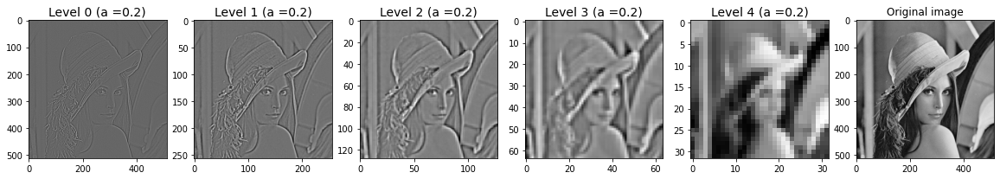

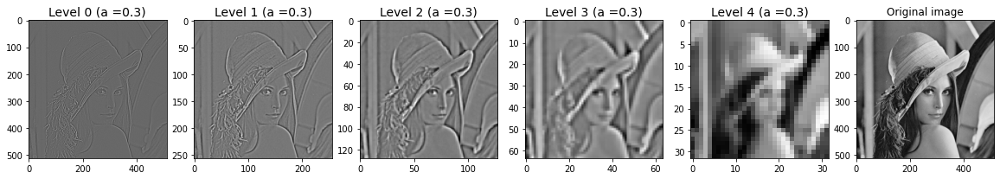

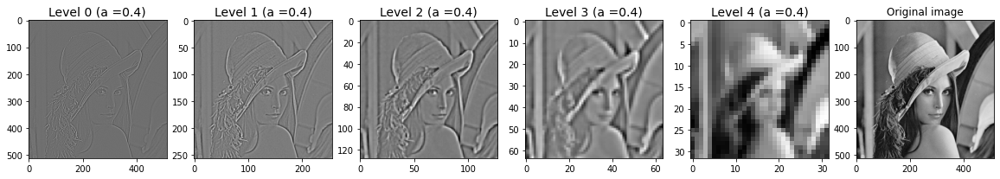

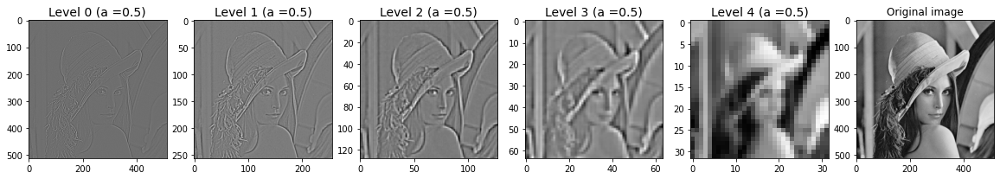

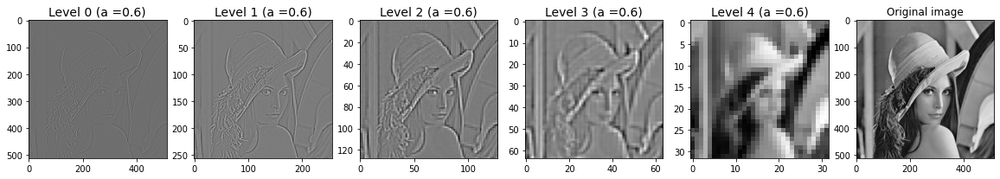

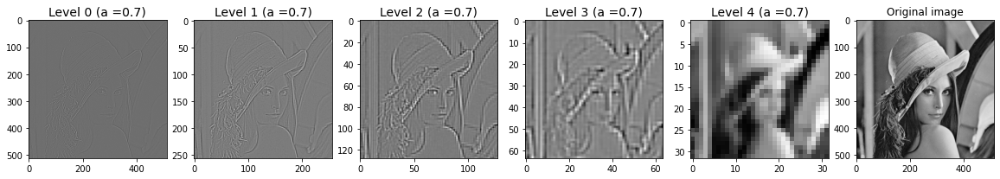

In [ ]:
Lena_gray_decoded=showLaplacianForValuesOfa(Lena_gray)

Για την εικόνα Lena RGB:

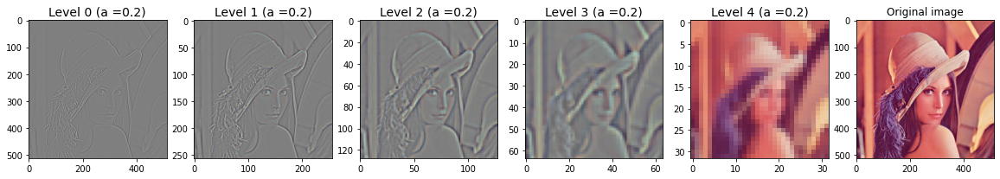

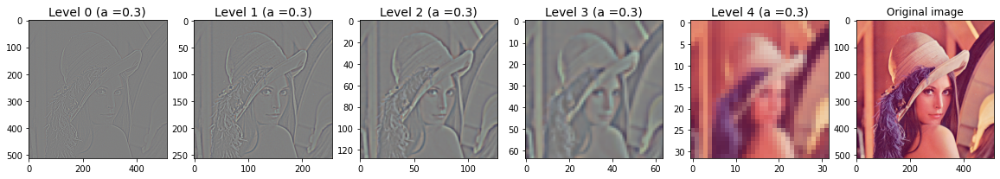

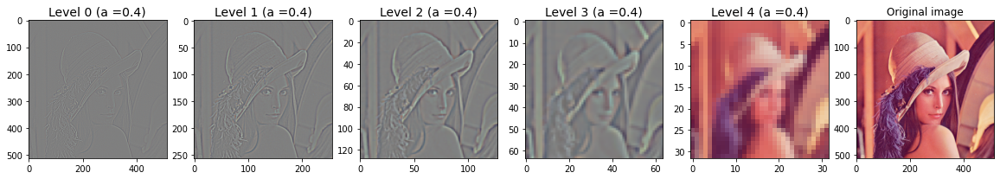

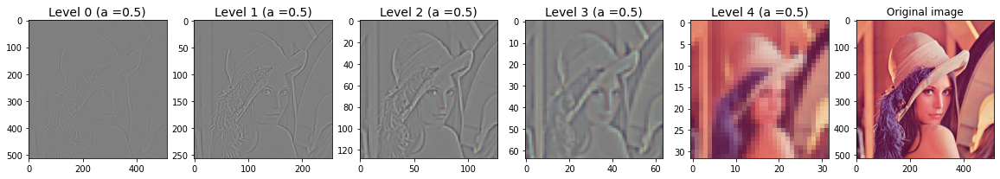

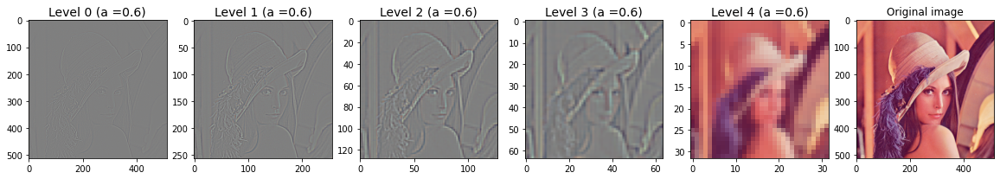

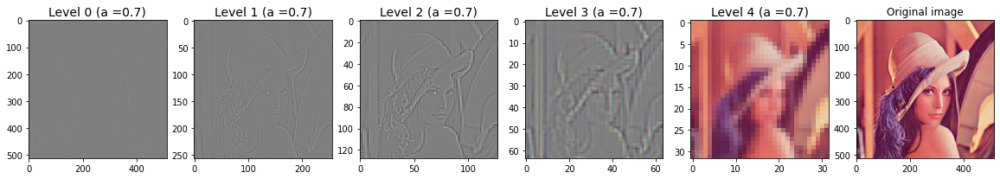

In [ ]:
Lena_RGB_decoded=showLaplacianForValuesOfa(Lena_RGB)

Για την εικόνα Camera:

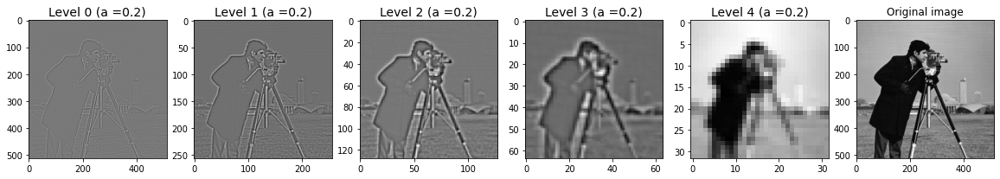

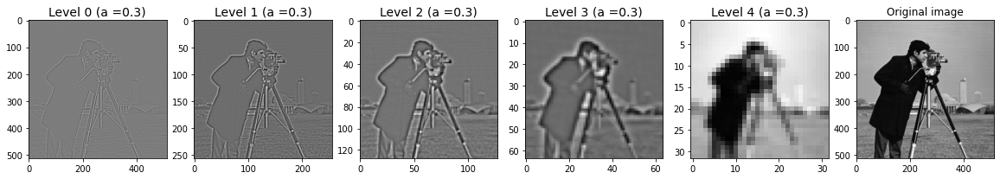

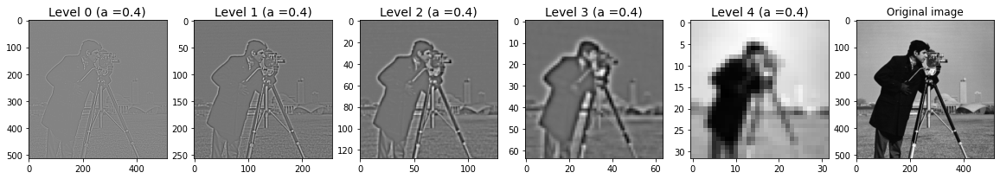

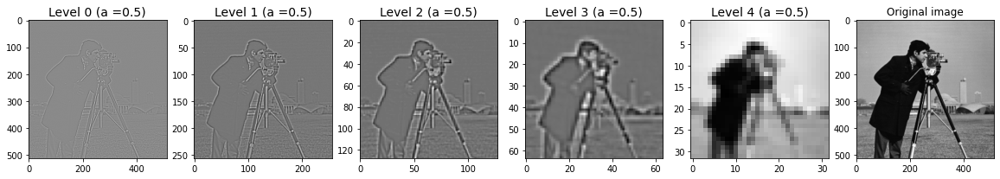

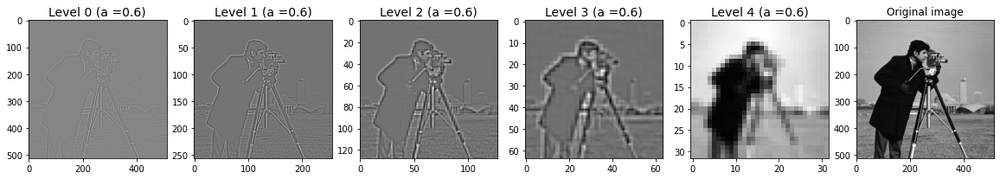

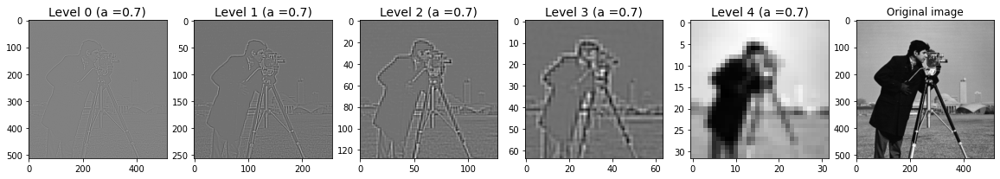

In [ ]:
Camera_decoded=showLaplacianForValuesOfa(Camera)

Με βάση τα παραπάνω αποτελέσματα παρατηρούμε ότι αύξηση του α υποβαθμίζει οπτικά την ποιότητα των εικόνων της πυραμίδας. Συγκεκριμένα, παρατηρούμε πως οι μεταβάσεις μεταξύ των χρωμάτων γίνονται πιο απότομες όσο αυξάνεται η τιμή της παραμέτρου α. Κάτι τέτοιο μπορεί να εξηγηθεί αν αναλογιστούμε πως η τιμή της παραμέτρου α επηρεάζει την μορφή του generating kernel που χρησιμοποιούμε, με μεγαλύτερες τιμές της παραμέτρου να οδηγούν σε μεγαλύτερη συμμετοχή των κεντρικών pixel σε σχέση με τα ακριανά κατά τον υπολογισμό του σταθμισμένου μέσου όρου ανά pixel, στην διαδικασία του γκαουσιανού φιλτραρίσματος και άρα τελικά οι μεταβάσεις γίνονται λιγότερο ομαλές. Περισσότερο αντιληπτή αυτή η υποβάθμιση της ποιότητας γίνεται στο επίπεδο 3 (4ο επίπεδο) της κάθε πυραμίδας. Σημειώνουμε όμως πως αν και η παράμετρος α επηρεάζει το οπτικό αποτέλεσμα, η ανακατασκευή της εικόνας από την Laplacian πυραμίδα παραμένει τελείως ανεξάρτηση της επιλογής της παραμέτρου α.

Στην συνέχεια παρουσιάζουμε, για διαφορετικές τιμές της παραμέτρου α τα αθροίσματα εικόνας που προκύπτουν κατά την αποκωδικοποίηση, σύμφωνα με την διαδικασία που περιγράφηκε στο θεωρητικό μέρος, δηλαδή κατά την άθροιση κάθε φορά την Λαπλασιανής εικόνας με το μέχρι τώρα άθροισμα εικόνας, αφού διπλασιάσουμε τις διαστάσεις αυτού:

In [ ]:
#Τροποποίηση της L_Pyramid_Decode, ώστε να τυπώνει ταυτόχρονα τα αθροίσματα εικόνας που υπολογίζει:
def L_Pyramid_Show_Decode_Levels(L,a):                                                      #input parameters: Laplacian pyramid, a
    f, ax = plt.subplots(1, len(L), figsize=(20, 20))  
    kernel = GKernel(a)
    sum_image=L[len(L)-1]
    if (len(sum_image.shape)==2):                                                           #grayscale image
      ax[0].imshow(L[len(L)-1].astype(int),cmap='gray')                                     #show lowpass image (top level of pyramid)
    else:
      ax[0].imshow(L[len(L)-1].astype(int))                                                 #color image                                  
    ax[0].set_title('Level {} '.format(len(L)-1)+'(a ='+str(a)+')', fontsize=14)
    tmp=0
    for i in range(len(L)-2, -1, -1):
        tmp=tmp+1
        expanded_image = GEXPAND(sum_image,kernel)                                          #expand image to obtain dimensions same as the previous level
        sum_image=L[i]+expanded_image-128                                                   #sum previous level to the sum image calculated so far
        if (len(sum_image.shape)==2):
          ax[tmp].imshow(sum_image.astype(int),cmap='gray')                                 #show sum image
        else:
          ax[tmp].imshow(sum_image.astype(int)) 
        ax[tmp].set_title('Level {} '.format(i)+'(a ='+str(a)+')', fontsize=14)             
    return sum_image                             

In [ ]:
#function to call L_Pyramid_Show_Decode_Levels for different values of a
def showDecoded(I_original):                                                                #input parameter: original image
    for a in range (2,8):
        a=a/10
        pyramid=LPyramid(I_original,a,5)
        L_Pyramid_Show_Decode_Levels(pyramid,a)

Για την εικόνα Lena grayscale:

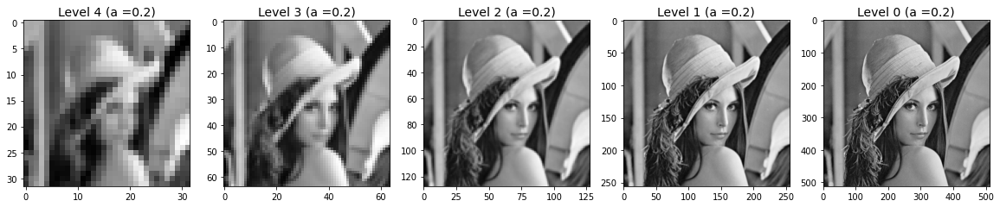

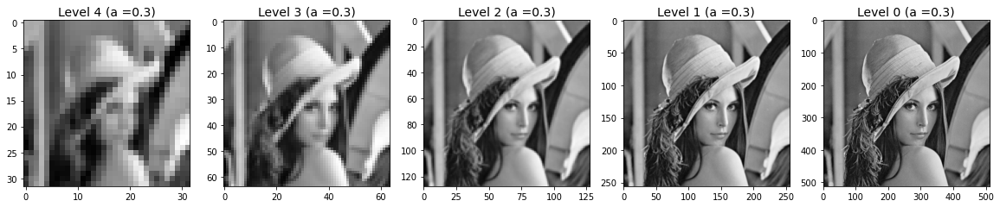

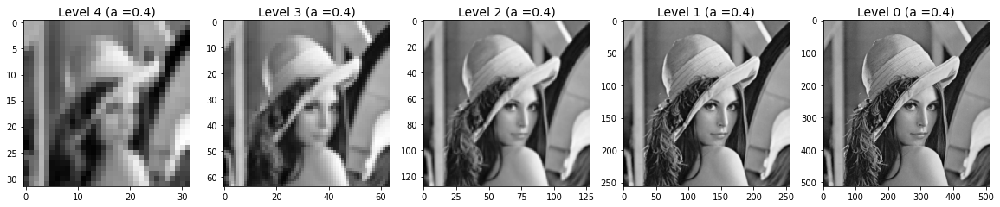

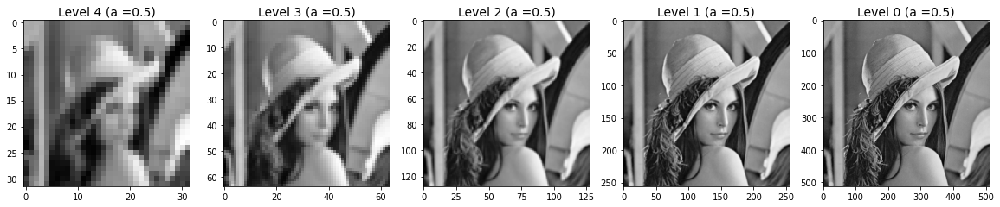

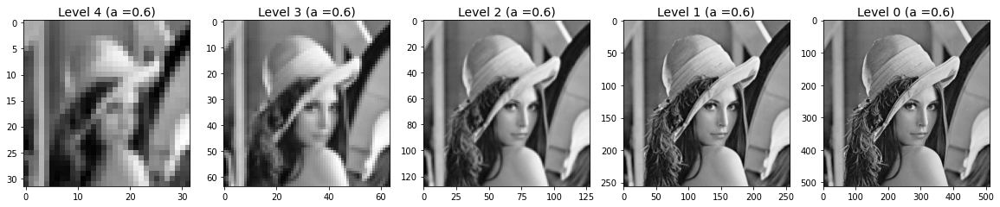

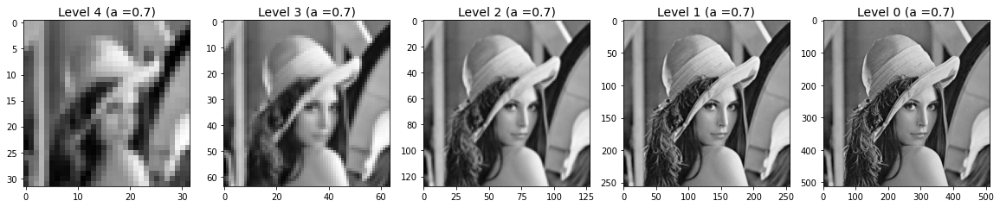

In [ ]:
showDecoded(Lena_gray)

Για την εικόνα Lena RGB:

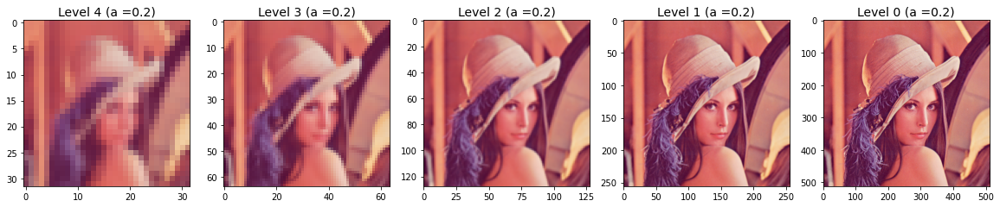

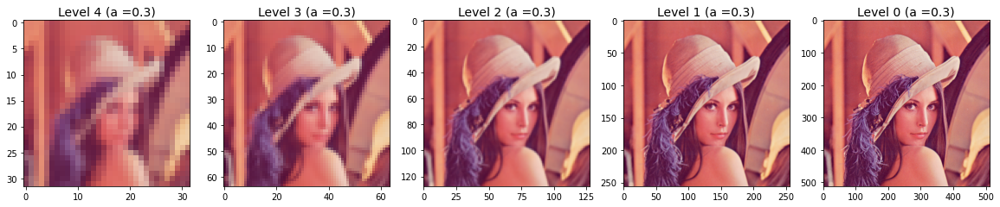

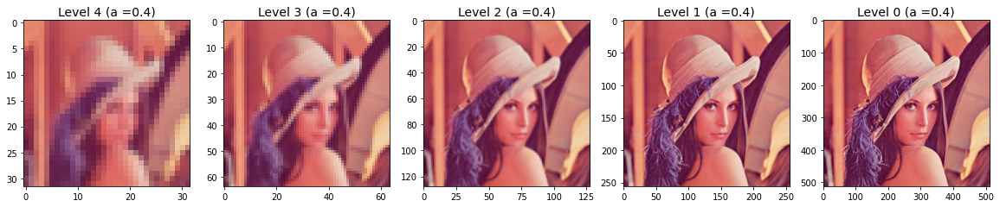

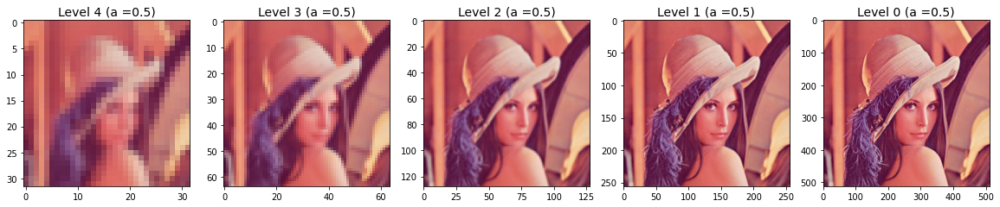

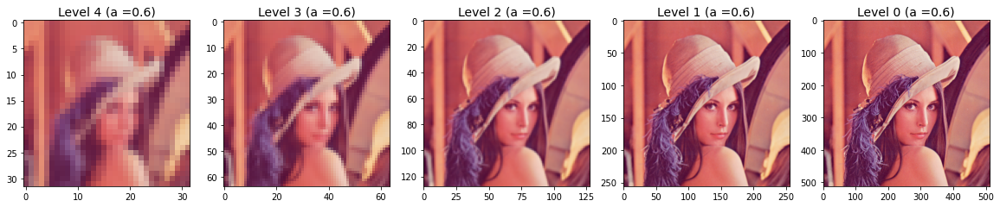

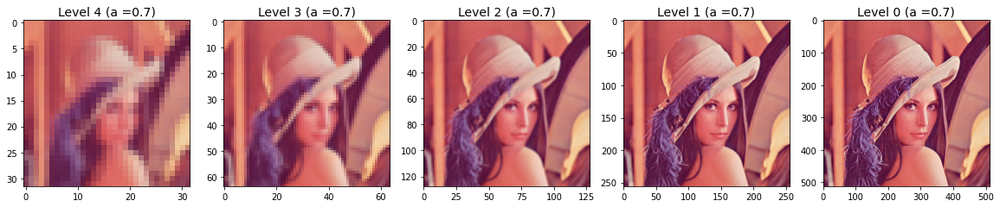

In [ ]:
showDecoded(Lena_RGB)

Για την εικόνα Camera:

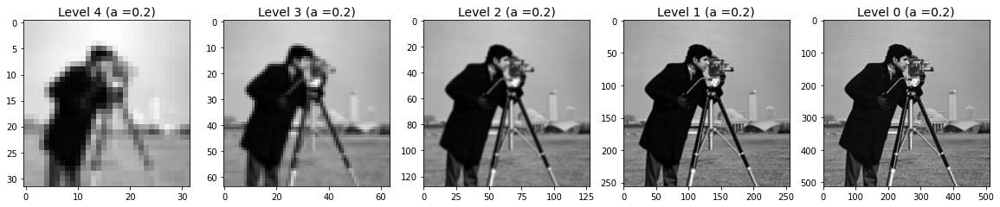

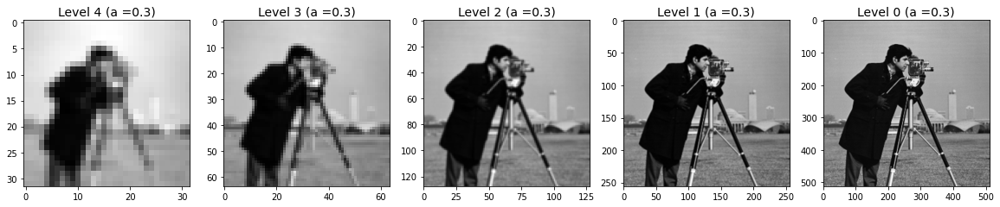

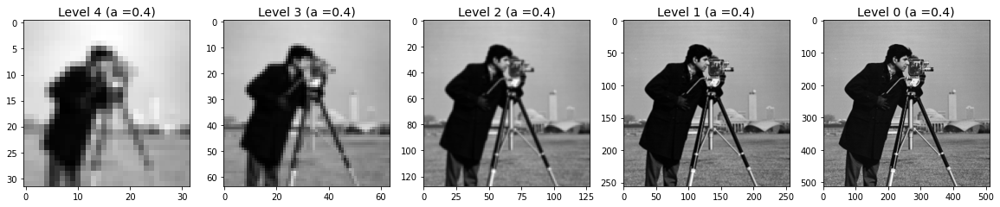

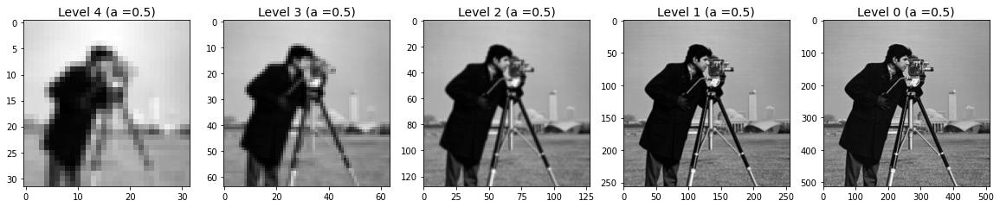

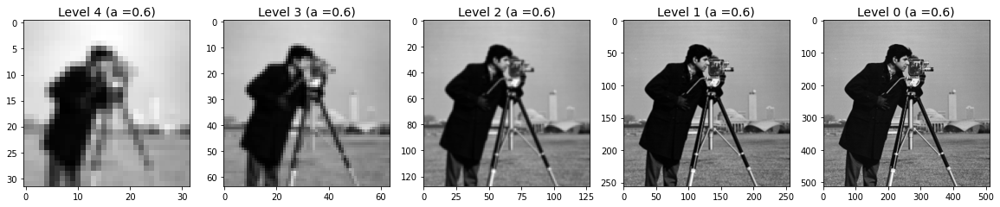

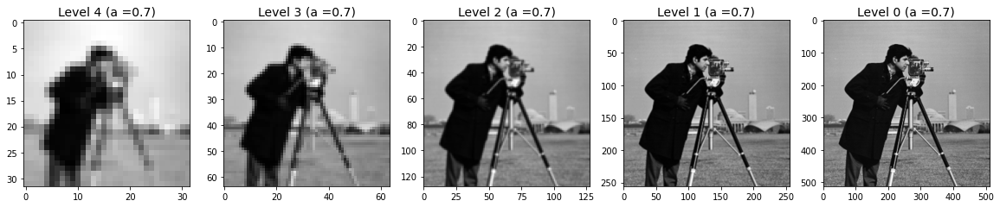

In [ ]:
showDecoded(Camera)

Σημειώνουμε ότι, το Level 0 που εμφανίζουμε είναι σε κάθε περίπτωση το τελευταίο επίπεδο ανακατασκευής, δηλαδή η αρχική εικόνα. Με βάση τα παραπάνω μπορούμε να παρατηρήσουμε ότι: 
* Ξεκινώντας από την κορυφή της Laplacian πυραμίδας, δηλαδή από το πιο βαθυπερατό κομμάτι της εικόνας (ταυτίζεται με την κορυφή της Gaussian πυραμίδας), προσθέτουμε σε κάθε στάδιο την εικόνα λεπτομέρειας του επόμενου (χαμηλότερου) επιπέδου της Λαπλασιανής πυραμίδας. Από την θολή βαθυπερατή εικόνα προκύπτει σε κάθε στάδιο μια εικόνα με όλο και περισσότερη λεπτομέρεια, με τις πιο coarse λεπτομέρειες να εμφανίζονται πρώτα και τα πιο λεπτά χαρακτηρηστικά να γίνονται εμφανή στην συνέχεια. Αυτό έχει σαν αποτέλεσμα τελικά σε κάθε άθροισμα να προκύπτει μία όλο και πιο crisp εικόνα, μέχρι να φτάσουμε στην ανακατασκευασμένη εικόνα η οποία ταυτίζεται με την αρχική.


* Όσον αφορά την επίδραση της μεταβολής του α, μπορούμε να παρατηρήσουμε πως αυτή δεν επιδρά στο οπτικό αποτέλεσμα των εικόνων αθροισμάτων αλλά ούτε και στην ποιότητα της ανακατασεκυασμένης εικόνας (έχουμε ακριβή ανακατασκευή).

**Ερώτημα γ):**

Εμφανίζουμε τώρα την Λαπλασιανή πυραμίδα για μεταβλητό depth (πλήθος επιπέδων) στο διάστημα [2,...,7]. Χρησιμοποιούμε τιμές στο προαναφερθέν διάστημα με step 1 και θέτουμε a=3/8. Εμφανίζουμε επίσης την αρχική εικόνα, χάριν σύγκρισης.

In [ ]:
#a function to show the pyramid for different values of depth
def showLaplacianForDepths(I_original):    
    for d in range (2,8):
        pyramid=LPyramid(I_original,3/8,d)                                          #compute the pyramid for a specific depth
        if (len(I_original.shape)==2):                                              #if the image is grayscale
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))  
            for i in range (0,len(pyramid)):                                        #plot the pyramids
                ax[i].imshow(pyramid[i], cmap="gray")                               # Base of the pyramid
                ax[i].set_title('Level {} '.format(i)+'(d ='+str(d)+')', fontsize=14)
            ax[i+1].imshow(I_original,cmap="gray")
            ax[i+1].set_title('Original image')
        else:                                                                       #if the image is RGB
            f, ax = plt.subplots(1, len(pyramid)+1, figsize=(20, 20))  
            for i in range (0,len(pyramid)):                                        #plot the pyramids
                ax[i].imshow(pyramid[i].astype(int))                                # Base of the pyramid
                ax[i].set_title('Level {} '.format(i)+'(d ='+str(d)+')', fontsize=14)
            ax[i+1].imshow(I_original)
            ax[i+1].set_title('Original image')

Για την εικόνα Lena grayscale:

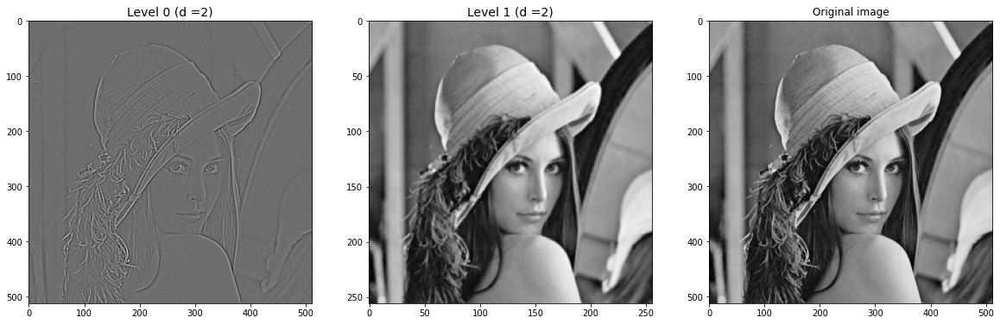

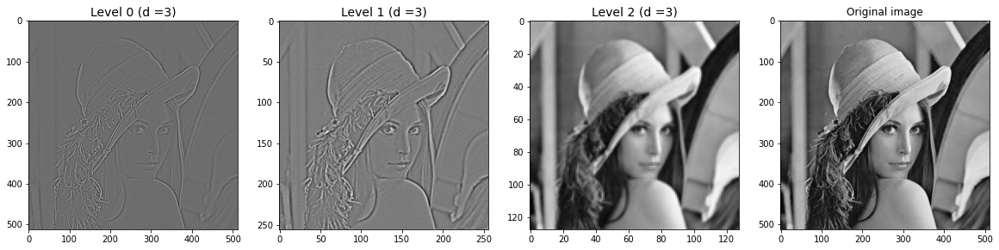

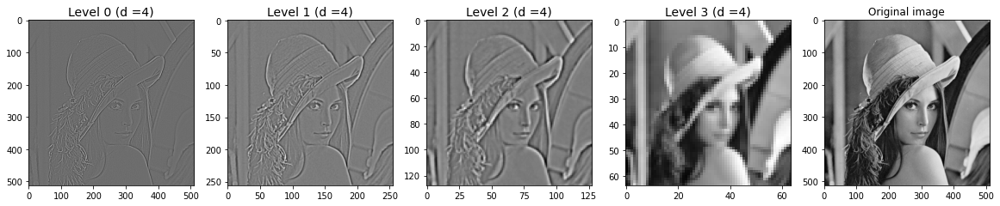

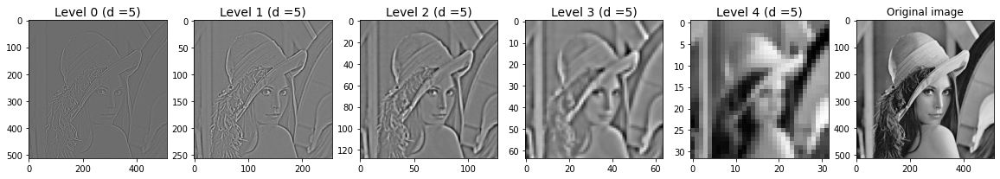

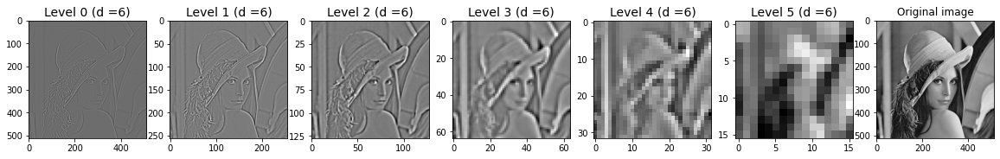

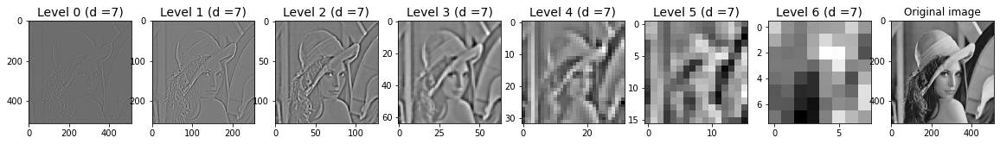

In [ ]:
Lena_gray_decoded=showLaplacianForDepths(Lena_gray)

Για την εικόνα Lena RGB:

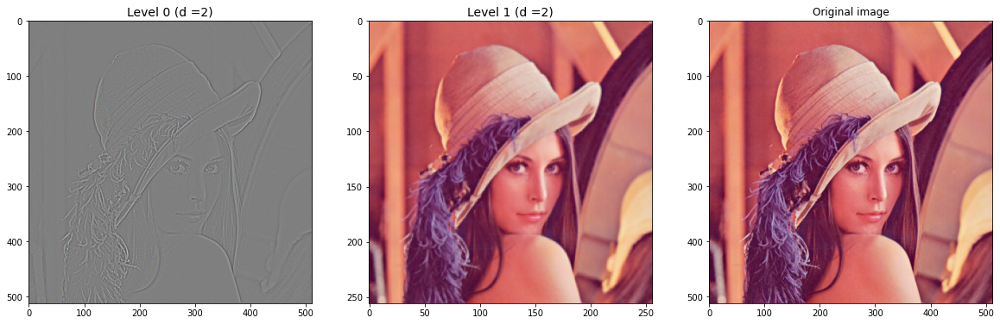

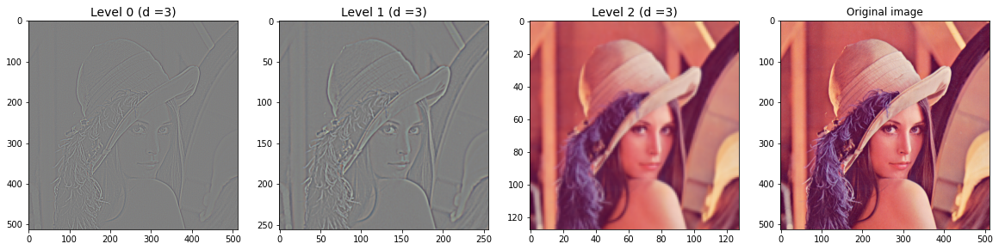

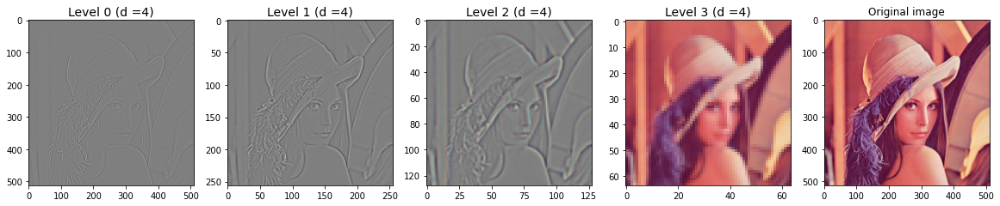

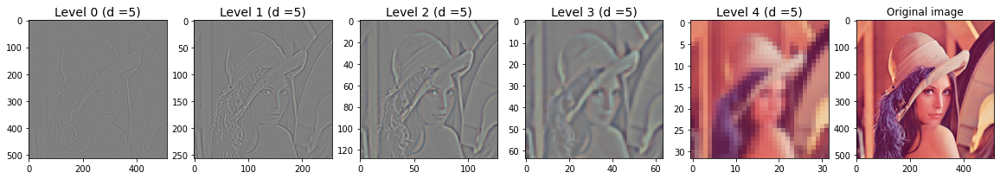

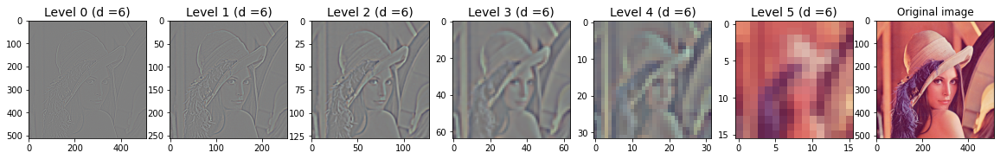

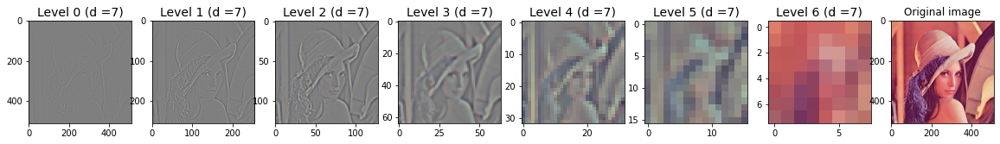

In [ ]:
Lena_RGB_decoded=showLaplacianForDepths(Lena_RGB)

Για την εικόνα Camera:

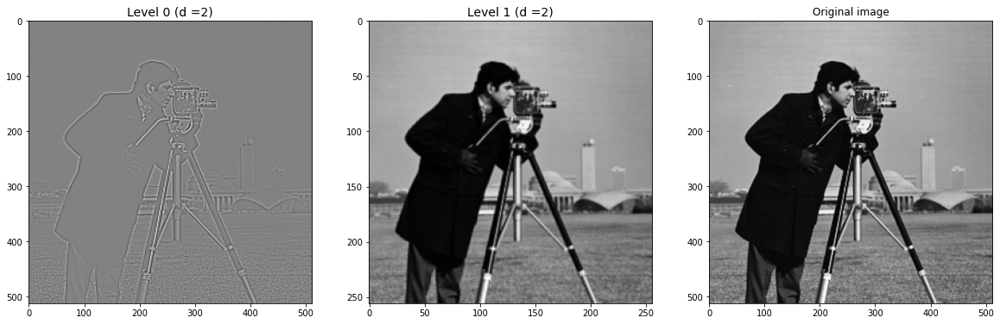

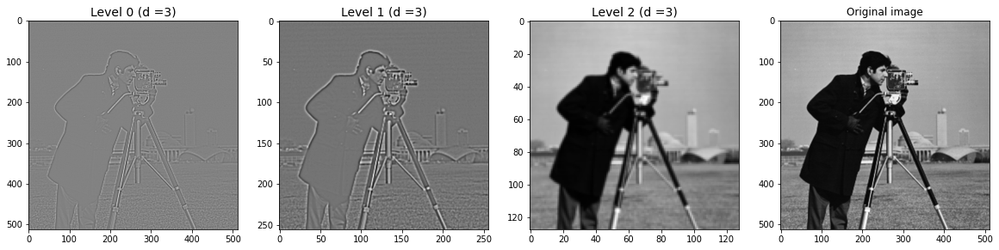

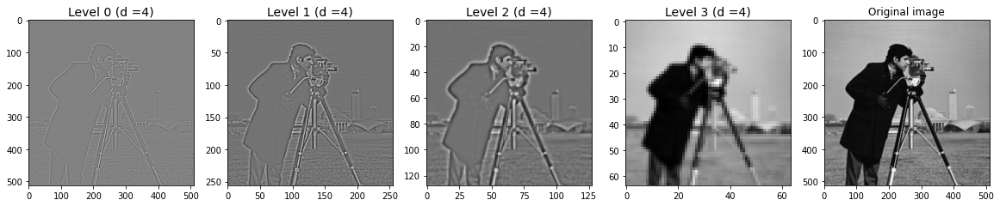

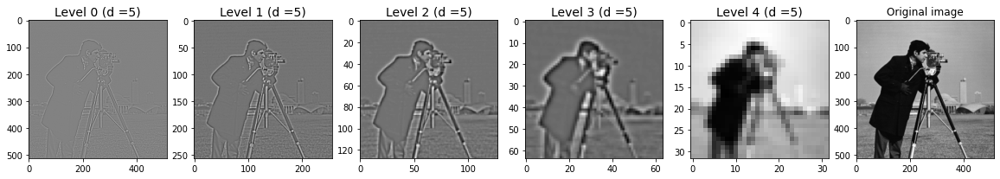

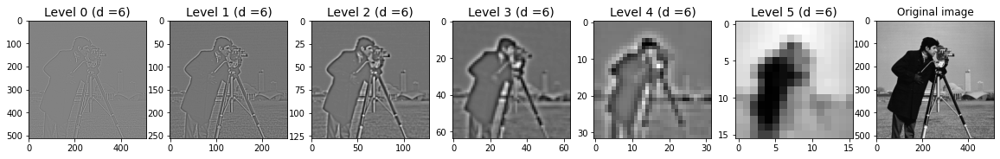

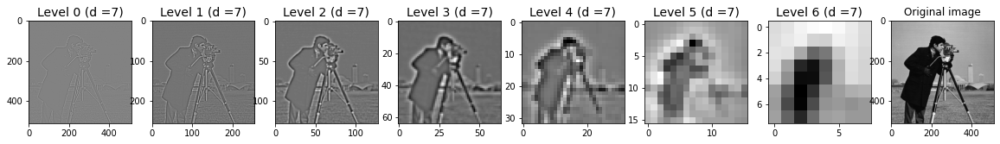

In [ ]:
Camera_decoded=showLaplacianForDepths(Camera)

Βλέπουμε πως με την αύξηση του αριθμού των επιπέδων, στο τελικό επίπεδο η εικόνα έχει χειρότερο οπτικό αποτέλεσμα:

 Για μικρότερο αριθμό επιπέδων η κορυφή της πυραμίδας κωδικοποιεί περισσότερη πληροφορία με μεγαλύτερη μέγιστη συχνότητα από την κορυφή μίας πυραμίδας περισσότερων επιπέδων άρα έχει, εκτός από μεγαλύτερες διαστάσεις, περισσότερη λεπτομέρεια. Αντίθετα, όσο αυξάνουμε τον αριθμό επιπέδων, έχουμε χωρισμό της εικόνας μας σε όλο και περισσότερα ζωνοπερατά τμήματα-επίπεδα λεπτομέρειας.

Στην συνέχεια παρουσιάζουμε τα αθροίσματα εικόνας που προκύπτουν κατά την αποκωδικοποίηση, σύμφωνα με την διαδικασία που περιγράφηκε στο θεωρητικό μέρος, δηλαδή κατά την άθροιση κάθε φορά την Λαπλασιανής εικόνας με το μέχρι τώρα άθροισμα εικόνας, αφού διπλασιάσουμε τις διαστάσεις αυτού:

In [ ]:
#Τροποποίηση της L_Pyramid_Decode, ώστε να τυπώνει ταυτόχρονα τα αθροίσματα εικόνας που υπολογίζει:
def L_Pyramid_Show_Decode_Levels_forDepths(L,a,depth):                                       #input parameters: Laplacian pyramid, a, pyramid depth
    f, ax = plt.subplots(1, len(L), figsize=(20, 20))  
    kernel = GKernel(a)
    sum_image=L[len(L)-1]
    if(len( sum_image.shape)==2):
      ax[0].imshow(L[len(L)-1].astype(int),cmap='gray') # top of the pyramid                 #show lowpass image (top level of pyramid)
    else:
      ax[0].imshow(L[len(L)-1].astype(int)) # top of the pyramid
    ax[0].set_title('Level {} '.format(len(L)-1)+'(d ='+str(depth)+')', fontsize=14)
    tmp=0
    for i in range(len(L)-2, -1, -1):
        tmp=tmp+1
        expanded_image = GEXPAND(sum_image,kernel)                                          #expand image to obtain dimensions same as the previous level
        sum_image=L[i]+expanded_image-128                                                   #sum previous level to the sum image calculated so far, substract 128, added earlier
        if(len(sum_image.shape)==2):                                                        #grayscale image
          ax[tmp].imshow(sum_image.astype(int),cmap='gray')                                 #show sum image
        else:                                                                               #color image
          ax[tmp].imshow(sum_image.astype(int),cmap='gray')
        ax[tmp].set_title('Level {} '.format(i)+'(d ='+str(depth)+')', fontsize=14)             
    return sum_image                             

In [ ]:
def showDecodedForDepths(I_original):
    for d in range (2,8):
        pyramid=LPyramid(I_original,3/8,d)
        L_Pyramid_Show_Decode_Levels_forDepths(pyramid,3/8,d)

Για την εικόνα Lena grayscale:

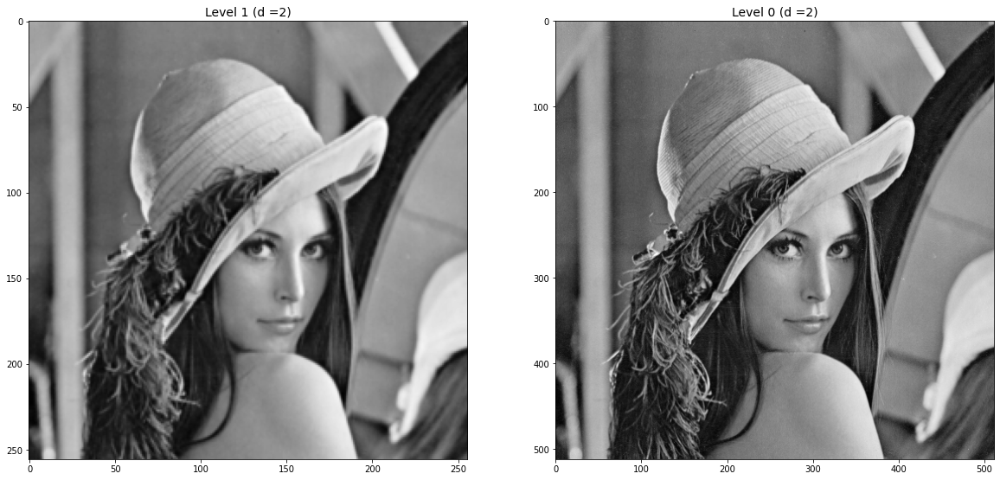

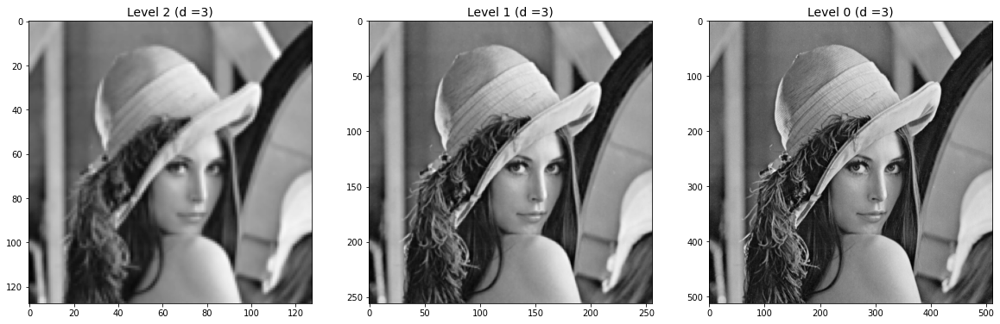

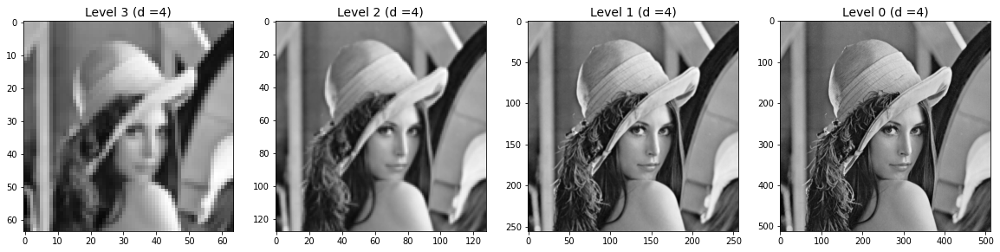

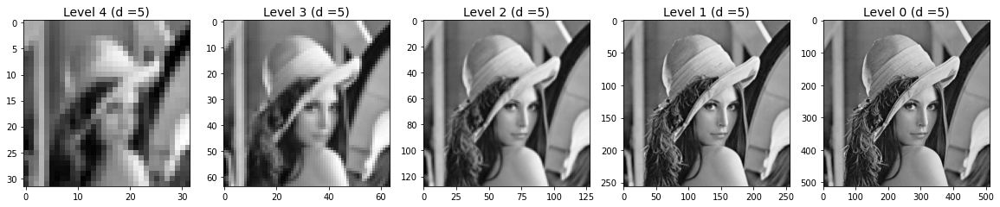

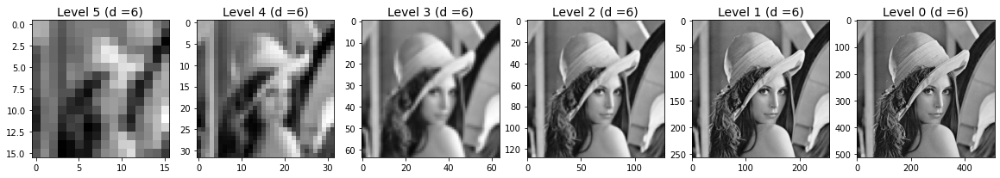

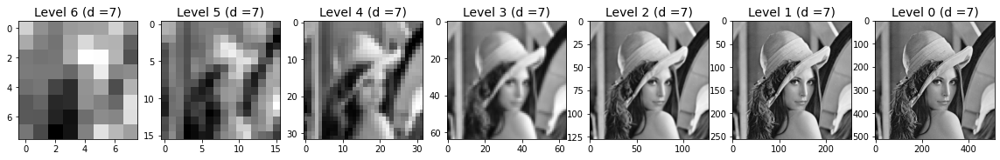

In [ ]:
showDecodedForDepths(Lena_gray)

Για την εικόνα Lena RGB:

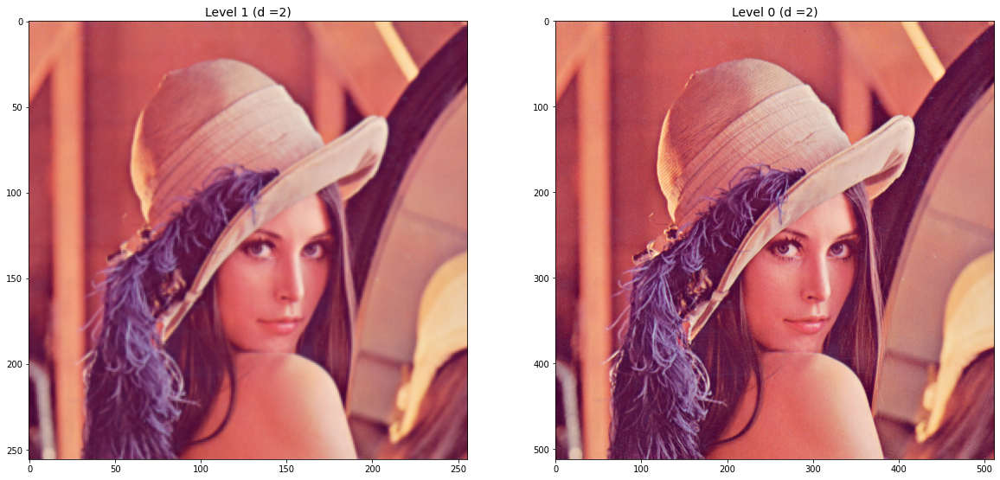

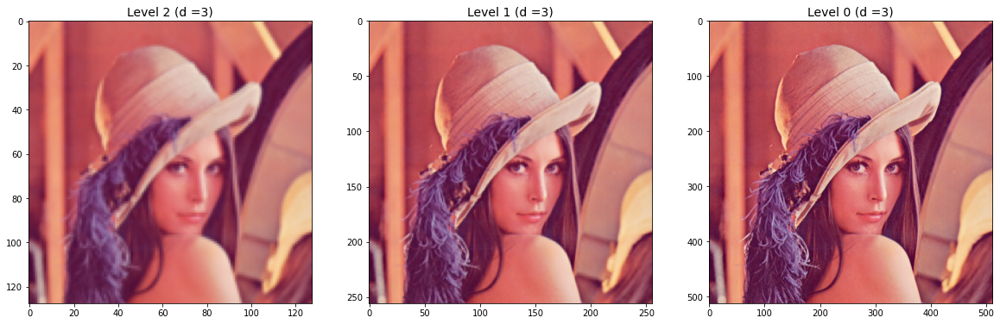

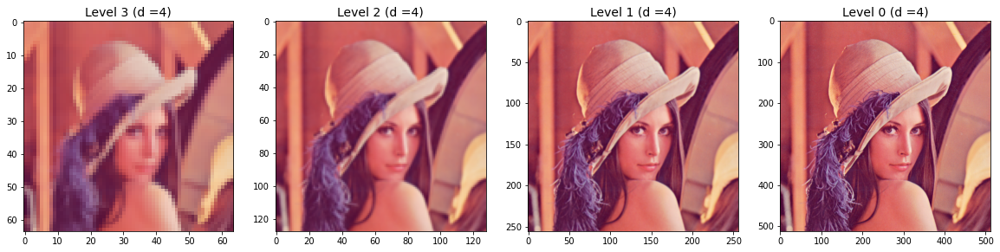

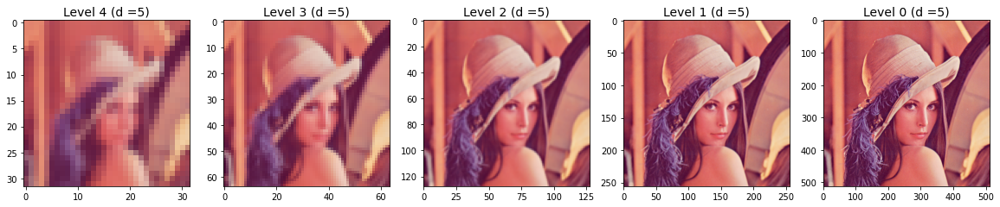

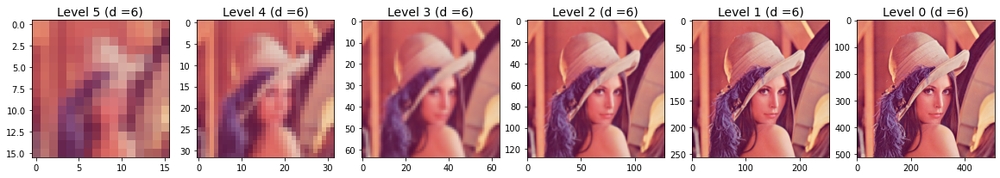

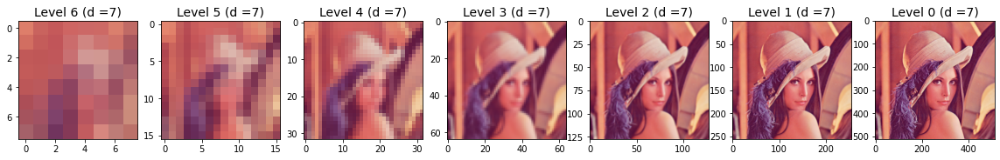

In [ ]:
showDecodedForDepths(Lena_RGB)

Για την εικόνα Camera:

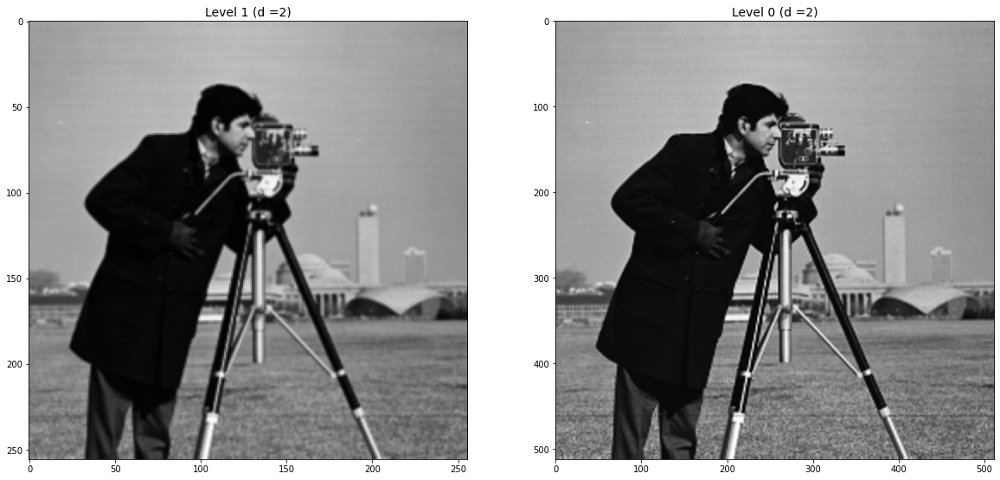

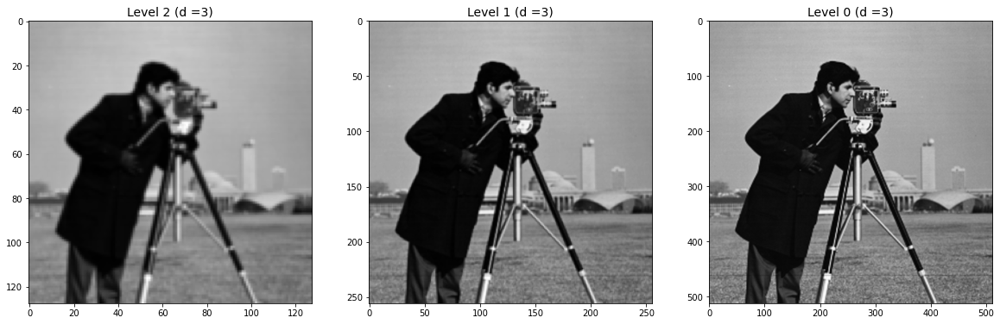

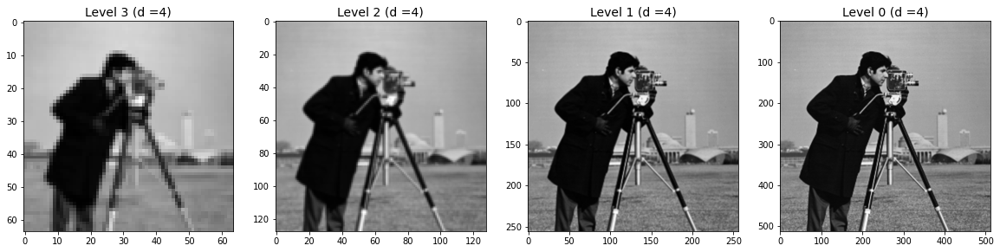

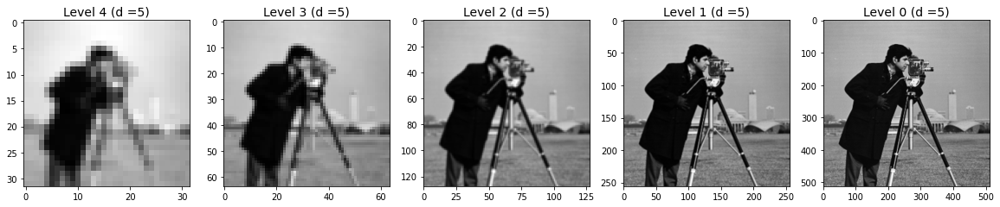

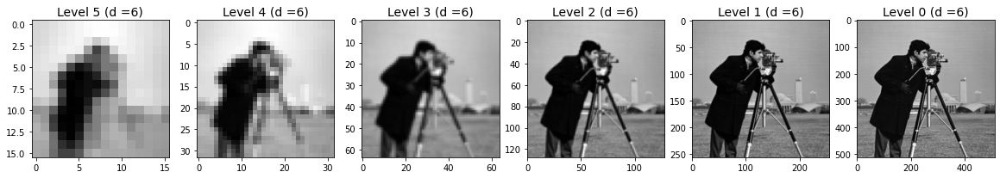

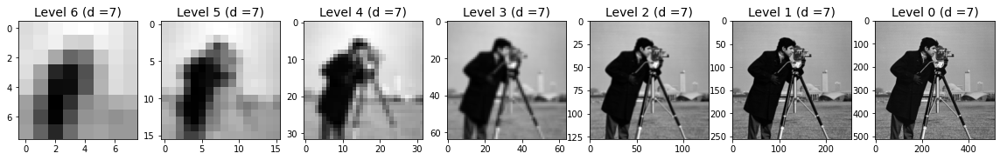

In [ ]:
showDecodedForDepths(Camera)


Από τα παραπάνω μπορούμε να παρατηρήσουμε πως ο αριθμός επιπέδων που θα επιλέξουμε για την πυραμίδα μας δεν επηρεάζει το τελικό αποτέλεσμα της αποκωδικοποιημένης εικόνας, η οποία είναι τέλεια ανακατασκευή της αρχικής. Αυτό που αλλάζει είναι το φάσμα (άρα το πόσο υψηλές συχνότητες- λεπτομέρειες περιέχει) της κορυφής της Λαπλασιανής πυραμίδας, καθώς όσο περισσότερα επίπεδα έχουμε τόσο περισσότερα βαθυπερατά φιλτραρίσματα έχουν προηγηθεί. 

Προφανώς, όσο περισσότερα επίπεδα χρησιμοποιούμε, έχουμε περισσότερες ενδιάμεσες εικόνες-αθροίσματα.Πιο αναλυτικά, όσο περισσότερα επίπεδα έχουμε, σε τόσο περισσοτερα ζωνοπερατά τμήματα είναι χωρισμένη η εικόνα μας (η λεπτομέρεια της αρχικής εικόνας) και έτσι για περισσότερα επίπεδα η κορυφή της πυραμίδας μας είναι πολύ θολή και η λεπτομέρεια προστίθεται σταδιακά κατά την διαδικασία ανακατασκευής.

**Ερώτημα δ):**

In [ ]:
import scipy.stats as st

In [ ]:
#A function to compute histogram for a specific pyramid and depth
def computeSumHist(LaplacianPyramid,depth):  
    sum_hist = np.zeros([256,1], np.float64)
    for n in range(depth-1):
        hist = cv2.calcHist(np.float32([LaplacianPyramid[n]]), [0], None, [256], [0, 256])       #calculate the histogram for every level and add it to an array
        sum_hist += hist
    return sum_hist

#A function to compute pyramid and histogram for a specific a and depth
def calcHist (Image,a,depth):  
    LaplacianPyramid=LPyramid(Image,a,depth)                                                     #compute the pyramid
    sum_hist = computeSumHist(LaplacianPyramid,depth)                                            #compute the histogram
    return sum_hist

#A function to show histograms with variable a in range [0.2,0.7]
def ShowHistogramsFora (Image,depth):  
    final_sum_hist=[]                                                                            #an array that keeps the histograms for each a
    entropy=[]
    variance=[]
    for i in range (2,8):
        i=i/10
        helper=calcHist(Image,i,depth)                                                           #calculate histogram
        a=np.max(helper)                                                                         #compute max value of the histogram
        final_sum_hist.append(helper)           
        entropy.append(st.entropy(helper/a)[0])                                                  #calculate entropy of normalised histogram
        variance.append(np.var(helper/a))                                                        #calculate variance of normalised histogram
    f, ax = plt.subplots(2, 3, figsize=(20, 10) ) 
    c=0.1
    for i in range (1,7):
        c += 0.1
        plt.subplot(2,3,i)
        plt.plot(final_sum_hist[i-1])                                                            #plot every histogram
        plt.title("Entropy = "+str(entropy[i-1])+" (a="+str(round(c,1))+")", fontsize=14) 
    return entropy,variance

#A function to show histograms with variable depth in range [2,7]        
def ShowHistogramsFordepth (Image,a):  
    final_sum_hist=[]                                                                            #an array that keeps the histograms for each depth
    entropy=[]
    for i in range (2,8):
        helper=calcHist(Image,a,i)                                                               #calculate histogram
        b=np.max(helper)                                                                         #compute max value of the histogram
        final_sum_hist.append(helper)
        entropy.append(st.entropy(helper/b)[0])                                                  #calculate entropy of normalised histogram
    f, ax = plt.subplots(2, 3, figsize=(20, 10) ) 
    c=1
    for i in range (1,7):
        c += 1
        plt.subplot(2,3,i)
        plt.plot(final_sum_hist[i-1])                                                            #plot every histogram
        plt.title("Entropy = "+str(entropy[i-1])+" (depth="+str(c)+")", fontsize=14) 
    return entropy

**Για μεταβλητό a παρουσιάζουμε τα κανονικοποιημένα ιστογράμματα:**

*Σημείωση: Επιλίγουμε βάθος πυραμίδας ίσο με 5*

Για την ασπρόμαυρη εικόνα Lena:

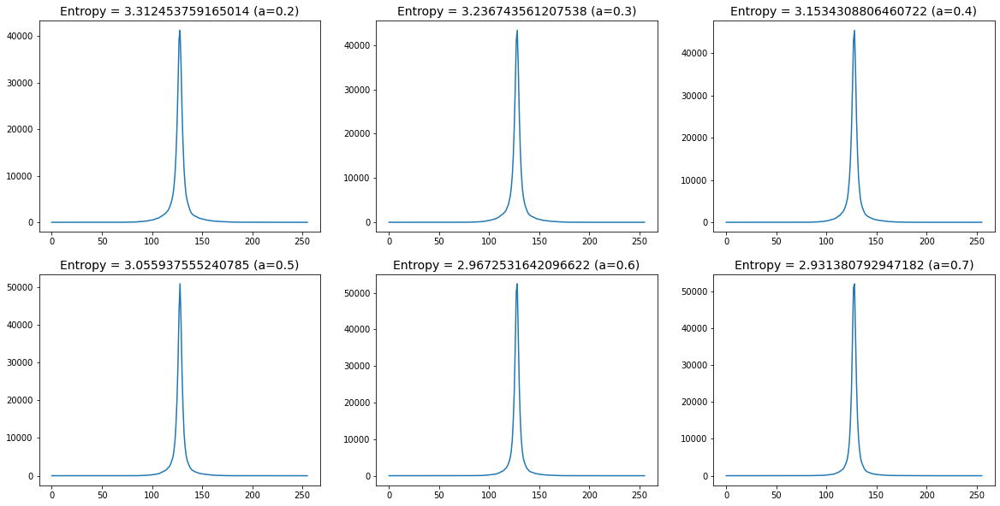

In [ ]:
[entropy_lena_grey,variance_lena_grey]=ShowHistogramsFora(Lena_gray,5) 

Για την έγχρωμη εικόνα Lena:

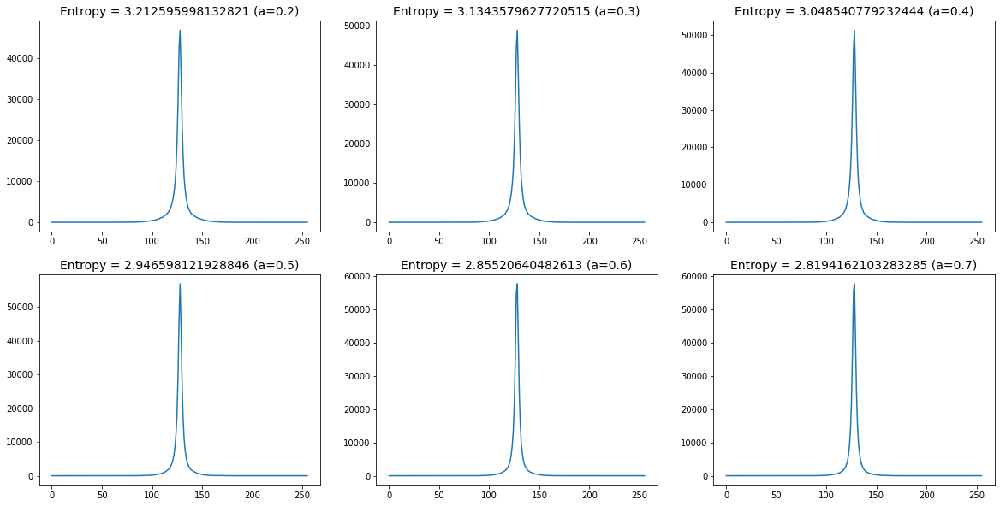

In [ ]:
[entropy_lena_rgb,variance_lena_rgb]=ShowHistogramsFora(Lena_RGB,5) 

Για την εικόνα Camera:

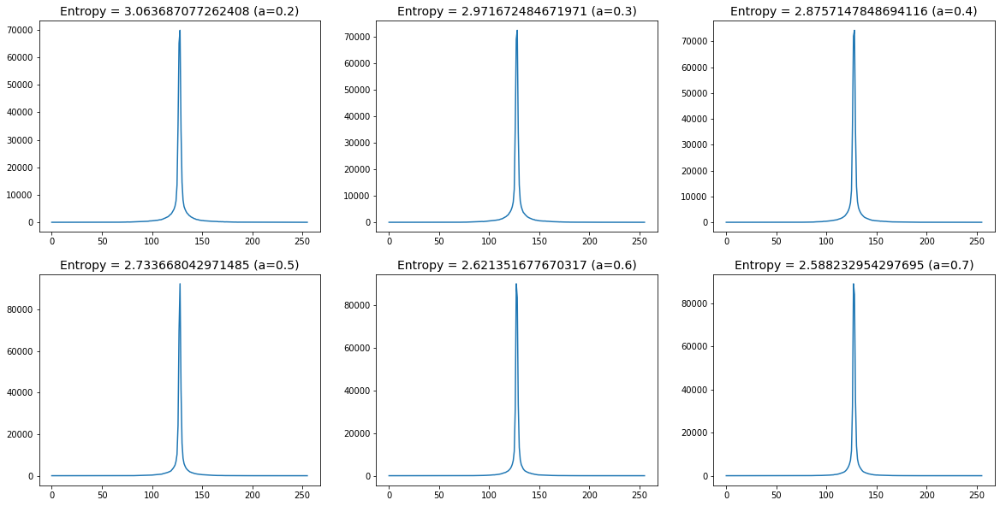

In [ ]:
[entropy_camera,variance_camera]=ShowHistogramsFora(Camera,5) 

Παρατηρούμε ότι η εντροπία μειώνεται συνεχώς για αύξηση του α. Υλοποιήσαμε την παρακάτω συνάρτηση για να δούμε πού παρουσιάζουν ελάχιστο η εντροπία και η διακύμανση:

In [ ]:
#A function to compute entropy and variance plots for a specific depth
def computeEntropyVariance (Image,depth,title):
    final_sum_hist=[]
    probs = [0.2,0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1]        #array that keeps values of x axis
    entropy=[]
    variance=[]
    tmp=0
    for i in range (0,17):
        tmp=probs[i]
        helper=calcHist(Image,tmp,depth)                                                                      #compute histogram for each depth value
        a=np.max(helper)                                                                                      #calculate max value of histogram
        final_sum_hist.append(helper/a)
        entropy.append(st.entropy(helper/a)[0])                                                               #calculate entropy of normalised histogram
        variance.append(np.var(helper/a))                                                                     #calculate variance of normalised histogram
    f, ax = plt.subplots(1, 2, figsize=(15, 4) ) 
    plt.subplot(1,2,1)
    plt.plot(probs, entropy, marker='.')                                                                      #plot entropy
    plt.title('Entropy of '+str(title)+' image')
    plt.xlabel('a')
    plt.ylabel('Entropy')
    plt.subplot(1,2,2)
    plt.plot(probs, variance, marker='.')                                                                     #plot variance
    plt.title('Variance of '+str(title)+' image')
    plt.xlabel('a')
    plt.ylabel('Variance')
    plt.show()
    return entropy,variance

Για την ασπρόμαυρη εικόνα Lena:

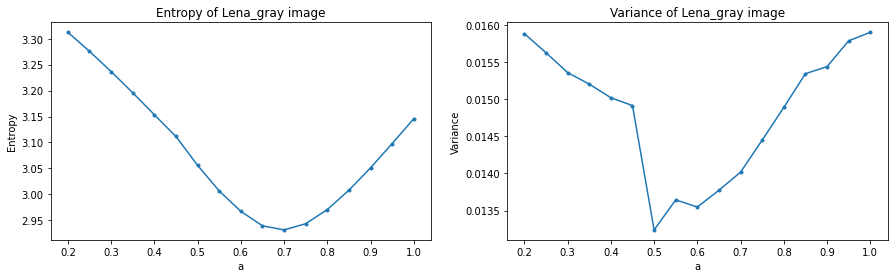

In [ ]:
[entropy_lena_grey,variance_lena_grey]=computeEntropyVariance(Lena_gray,5,"Lena_gray")

Για την έγχρωμη εικόνα Lena:

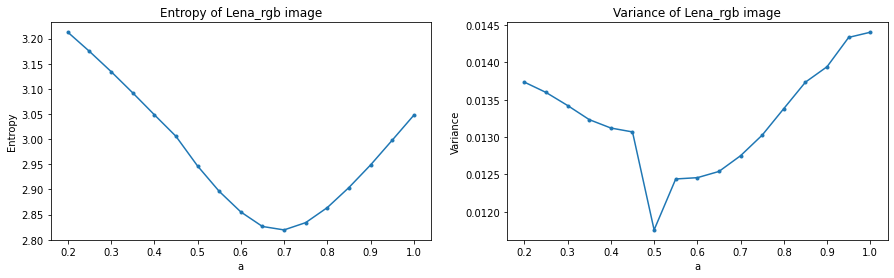

In [ ]:
[entropy_lena_rgb,variance_lena_rgb]=computeEntropyVariance(Lena_RGB,5,"Lena_rgb")

Για την εικόνα Camera:

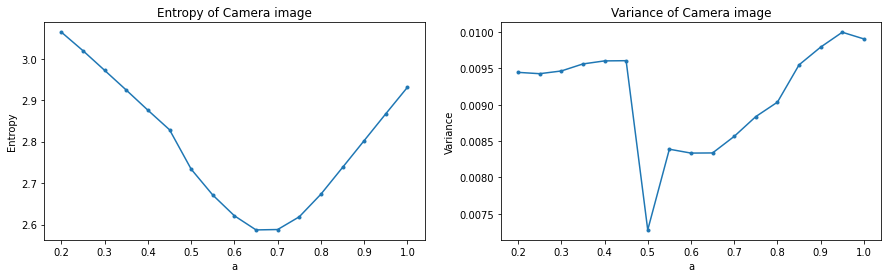

In [ ]:
[entropy_camera,variance_camera]=computeEntropyVariance(Camera,5,"Camera")

Όπως βλέπουμε, η εντροπία παρουσιάζει τοπικό ελάχιστο το οποίο μεταβάλλεται ανάλογα με την εικόνα παραμένοντας ωστόσο σε χαμηλό επίπεδο (χαμηλότερο του επιπέδου της εντροπίας της αρχικής εικόνας), όπως ήταν αναμενόμενο δεδομένης της αποσυσχέτισης των pixel των εικόνων της Λαπλασιανής πυραμίδας. Ακόμα, παρατηρούμε ότι σε κάθε περίπτωση το τοπικό ελάχιστο εμφανίζεται στο διάστημα [0.6,0.7] για την παράμετρο α, κάτι το οποίο βρίσκεται σε συμφωνία με την θεωρητική ανάλυση του paper της εκφώνησης. 

Αντίθετα, παρατηρούμε ότι το variance δεν ακολουθεί σταθερή κατανομή και παρουσιάζει ελάχιστο για α = 0.5 και άρα συμπεραίνουμε ότι για τιμές του α στο διάστημα [0.5,0.7] μπορούμε να πετύχουμε μια αρκετά χαμηλή τιμή τόσο στην εντροπία όσο και στην διακύμανση  κάτι το οποίο μας επιτρέπει να έχουμε τον ελάχιστο αριθμό  από bits ανά pixel που χρειάζονται για την κωδικοποίηση της εκάστοτε εικόνας.

**Για μεταβλητό depth έχουμε:**

Για την ασπρόμαυρη εικόνα Lena:

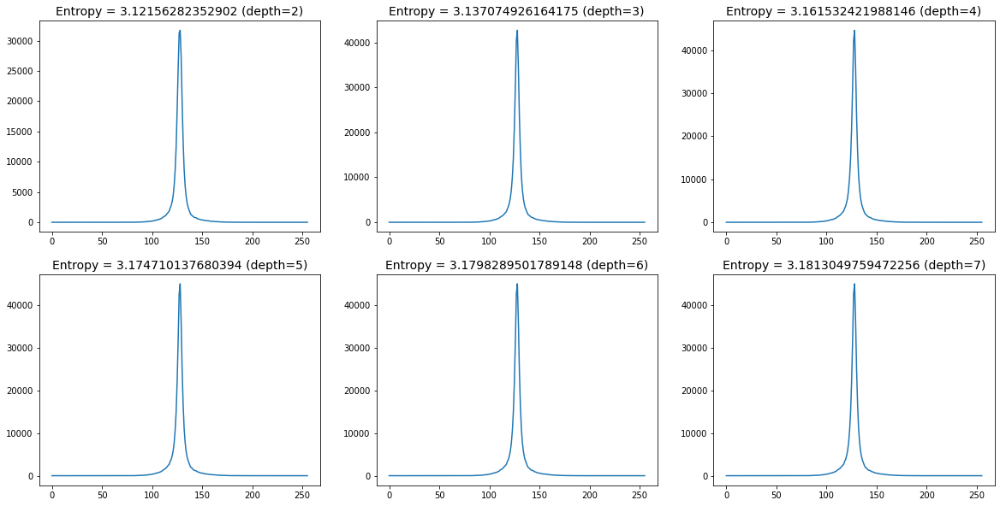

In [ ]:
entropy_lena_gray=ShowHistogramsFordepth(Lena_gray,3/8)

Για την έγχρωμη εικόνα Lena:

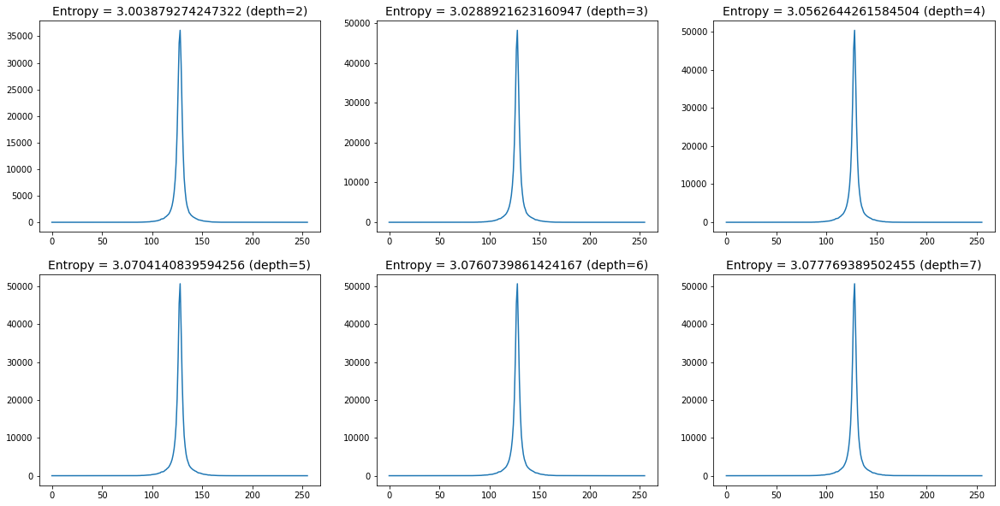

In [ ]:
entropy_lena_rgb=ShowHistogramsFordepth(Lena_RGB,3/8)

Για την εικόνα Camera:

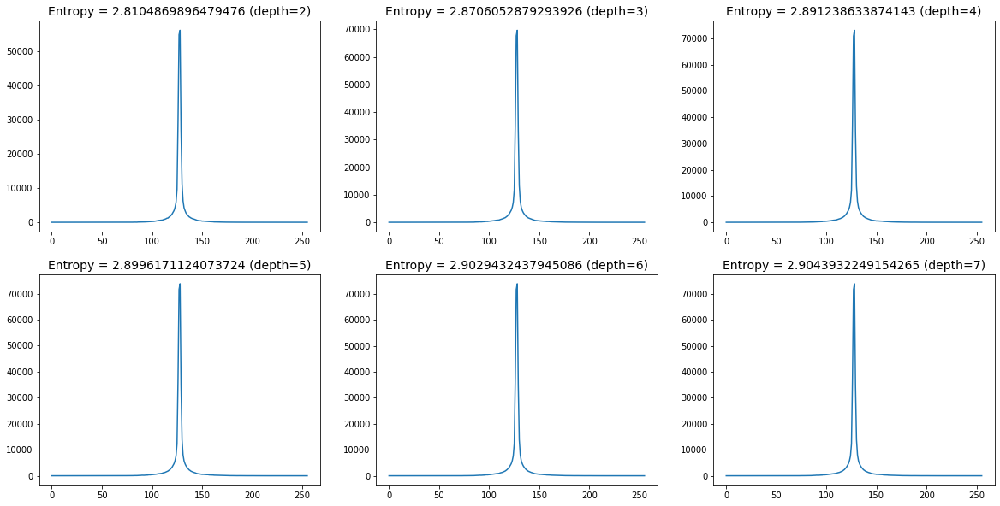

In [ ]:
entropy_camera=ShowHistogramsFordepth(Camera,3/8)

In [ ]:
#A function to compute entropy plot for a specific a
def computeEntropyVarianceDepth (Image,a,title):
    entropy=[]
    probs=np.arange(2,8,1)                                                                    #an array that stores the values for x axis
    for i in range (2,8):
        helper=calcHist(Image,a,i)                                                            #compute histogram for a specific depth
        b=np.max(helper)                                                                      #caclulate max value of histogram
        entropy.append(st.entropy(helper/b)[0])                                               #compute entropy of normalised histogram
    plt.plot(probs, entropy, marker='.')                                                      #plot entropy
    plt.title('Entropy of '+str(title)+' image')
    plt.xlabel('depth')
    plt.ylabel('Entropy')
    return entropy


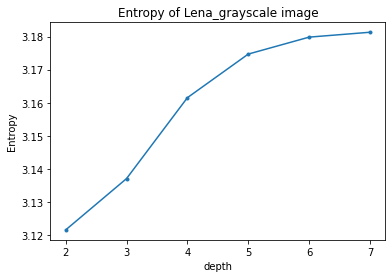

In [ ]:
entropy_lena_grey=computeEntropyVarianceDepth(Lena_gray,3/8,"Lena_grayscale")

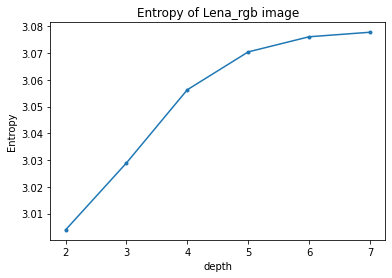

In [ ]:
entropy_lena_rgb=computeEntropyVarianceDepth(Lena_RGB,3/8,"Lena_rgb")

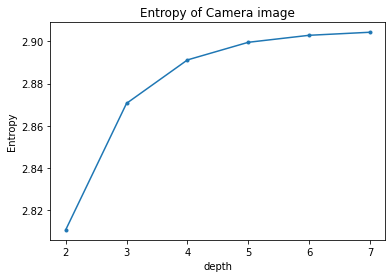

In [ ]:
entropy_camera=computeEntropyVarianceDepth(Camera,3/8,"Camera")

Με βάση τα παραπάνω αποτελέσματα παρατηρούμε ότι η παράμετρος depth δεν επηρεάζει σε μεγάλο βαθμό την εντροπία καθώς βλέπουμε ότι υπάρχει μία μικρή μόνο αύξηση της, της τάξης δεκαδικών ψηφίων, κάτι το οποίο μας οδηγεί στο συμπέρασμα ότι η παράμετρος depth δεν αποτελεί βασικό κριτήριο για την ελαχιστοποίηση της εντροπίας.

**Ερώτημα ε):**

Στο ερώτημα αυτό μας ζητήθηκε να βρούμε το βέλτιστο α ελαχιστοποιώντας ταυτόχρονα την εντροπία και την διακύμανση των τιμών ανά επίπεδο. Επιλέγουμε να μεταβάλλουμε το α κρατώντας σταθερό το depth μιας και όπως προαναφέρθηκε, η παράμετρος depth επηρεάζει σε πολύ μικρό βαθμό την εντροπία καθιστώντας το α την καθοριστική παράμετρο για την ελαχιστοποίηση αυτής. 

Σύμφωνα με την θεωρητική ανάλυση του paper γνωρίζουμε ότι για τη ελαχιστοποιήση της συσχέτισης μεταξύ των pixels ευθύνεται η εντροπία και η διακύμανση, επομένως σκοπός μας ήταν η εύρεση του α τέτοιου ώστε να υπάρχει ελαχιστοποίηση τόσο της εντροπίας όσο και της διακύμανσης σε όσο το δυνατόν περισσότερα επίπεδα της πυραμίδας.  Έτσι, υπολογίσαμε το ιστόγραμμα ανά επίπεδο κάθε πυραμίδας και με αυτό μπορέσαμε να βρούμε την εντροπία και την διακύμανση του κάθε επιπέδου.

Σημειώνεται ότι για την παράμετρο depth χρησιμοποιήσαμε την τιμή 5 καθώς όπως αναφέραμε η παράμετρος αυτή δεν επηρεάζει σημαντικά την εντροπία. 

In [ ]:
#A function to compute histogram for a specific pyramid level
def computeSumHistByLevel(LaplacianPyramid,depth,i):  
    hist = cv2.calcHist(np.float32([LaplacianPyramid[i]]), [0], None, [256], [0, 256])                        #compute histogram for pyramid level i
    return hist/hist.max()

#A function to compute pyramid and histogram for a specific a, depth and level i
def calcHistByLevel (Image,a,depth,i): 
    LaplacianPyramid=LPyramid(Image,a,depth)                                                                  #compute Laplacian pyramid
    sum_hist = computeSumHistByLevel(LaplacianPyramid,depth,i)                                                #compute histogram
    return sum_hist

#A function to plot entropy and variance for every level of the pyramid, for a in range [0.2,1]
def computeEntropyVarianceByLevel (Image,depth,title):
    final_sum_hist=[]
    probs = [0.2,0.25, 0.3, 0.35, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8, 0.85, 0.9, 0.95, 1]        #an array that holds the values for x axis
    tmp=0
    for j in range (0,5):                                                                                     #for each level
        entropy=[]
        variance=[]
        for i in range (0,17):                                                                                #for each a
            tmp=probs[i]
            helper=calcHistByLevel(Image,tmp,depth,j)                                                         #compute histogram
            a=np.max(helper)                                                                                  #calculate max value
            final_sum_hist.append(helper/a)                                                             
            entropy.append(st.entropy(helper/a)[0])                                                           #compute entropy of the normalised histogram
            variance.append(np.var(helper/a))                                                                 #compute variance of the normalised histogram
        f, ax = plt.subplots(1, 2, figsize=(15, 4) ) 
        plt.subplot(1,2,1)
        plt.plot(probs, entropy, marker='.')                                                                  #plot the entropy of each level
        plt.title('Entropy of '+str(title)+' image, level '+str(j))
        plt.xlabel('a')
        plt.ylabel('Entropy')
        plt.subplot(1,2,2)
        plt.plot(probs, variance, marker='.')                                                                 #plot the variance of each level
        plt.title('Variance of '+str(title)+' image, level '+str(j))
        plt.xlabel('a')
        plt.ylabel('Variance')
        plt.show()
    return entropy,variance

Παρακάτω παρουσιάζονται τα διαγράμματα της εντροπίας και της διακύμανσης για διαφορετικές τιμές της παραμέτρου α για κάθε επίπεδο της προκύπτουσας Λαπλασιανής πυραμίδας προκειμένου να είναι δυνατή η οπτική σύγκριση των ελαχίστων τιμών.

Για την εικόνα Lena grayscale:

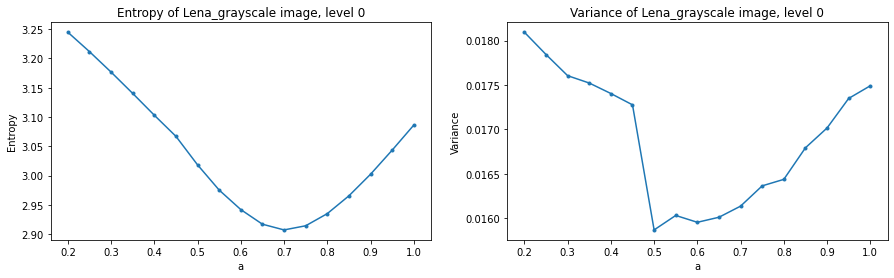

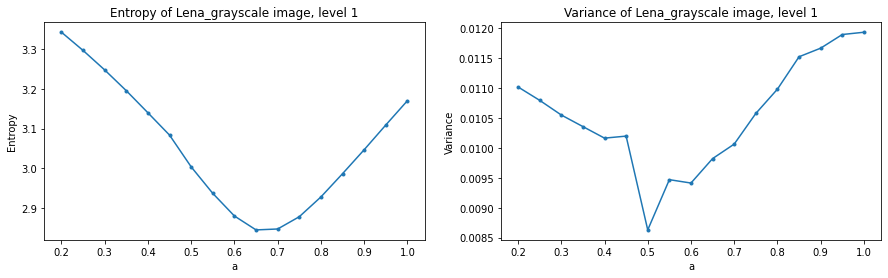

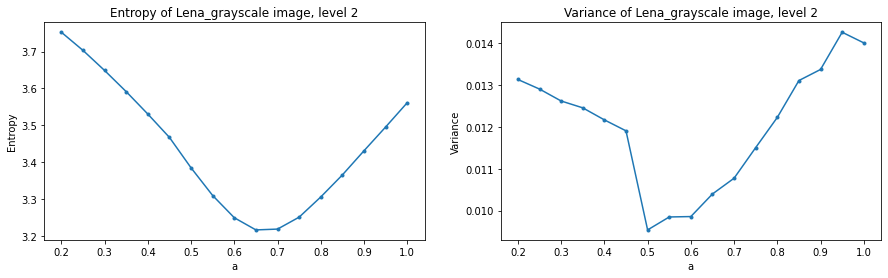

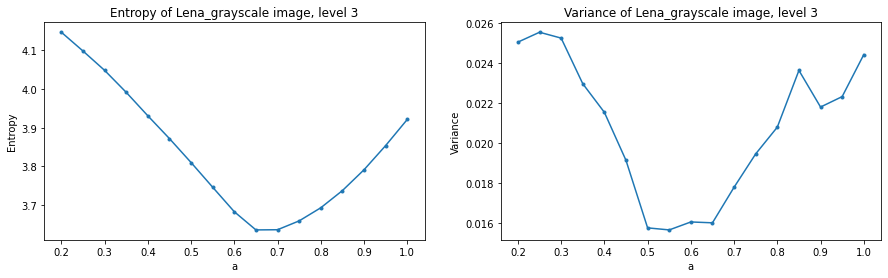

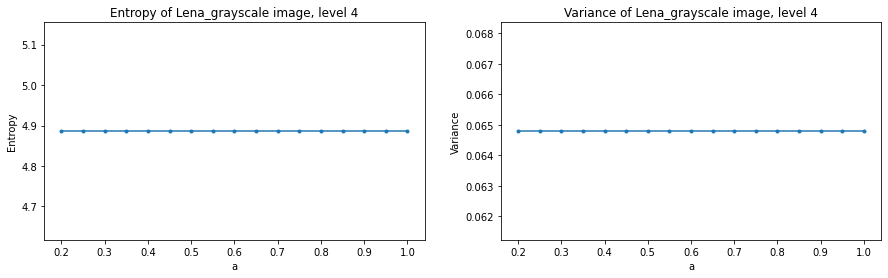

In [ ]:
[entropy_lena_grey,variance_lena_grey]=computeEntropyVarianceByLevel(Lena_gray,5,"Lena_grayscale")

Για την εικόνα Lena RGB:

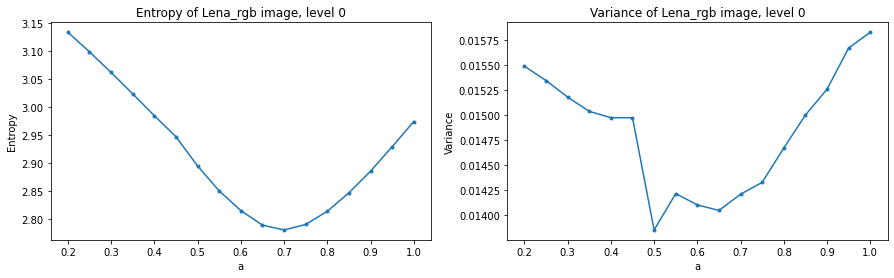

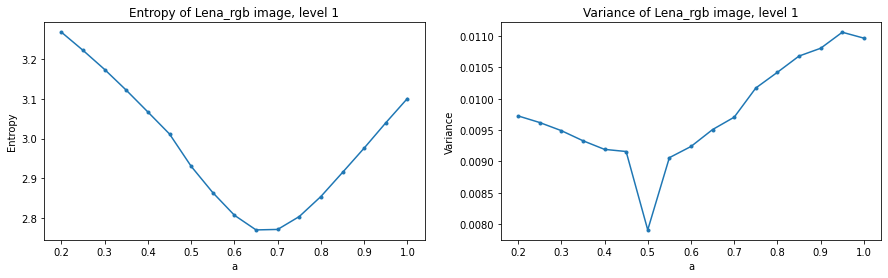

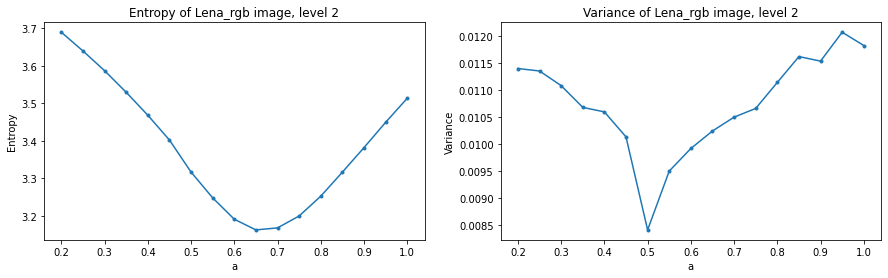

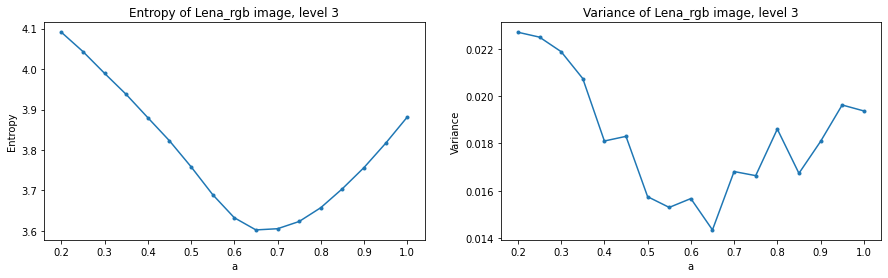

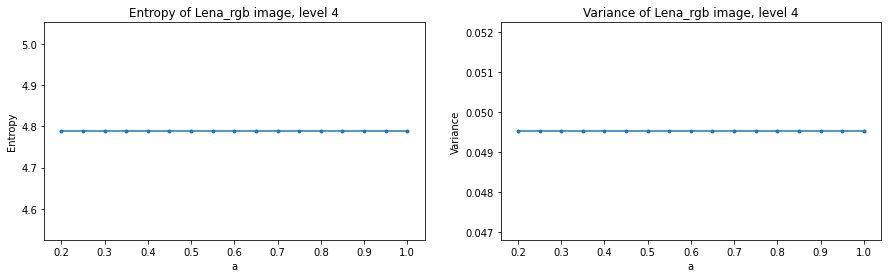

In [ ]:
[entropy_lena_rgb,variance_lena_rgb]=computeEntropyVarianceByLevel(Lena_RGB,5,"Lena_rgb")

Για την εικόνα Camera:

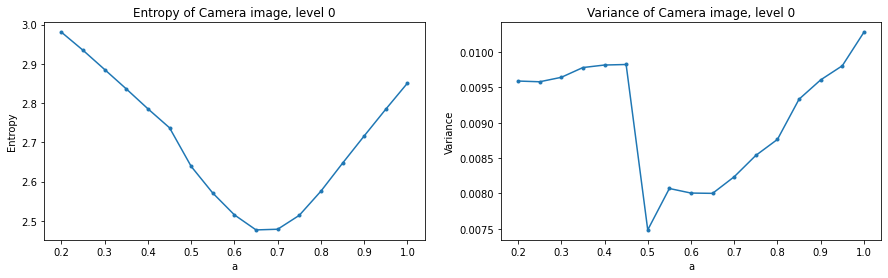

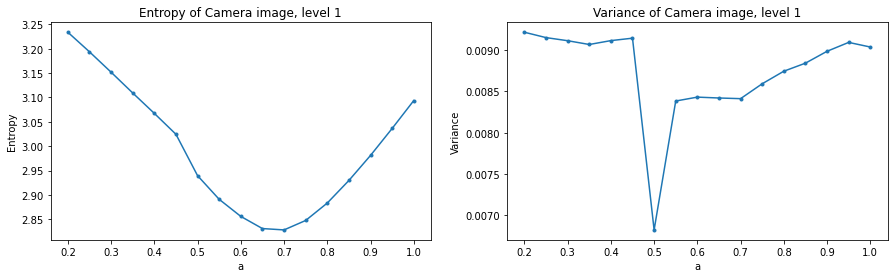

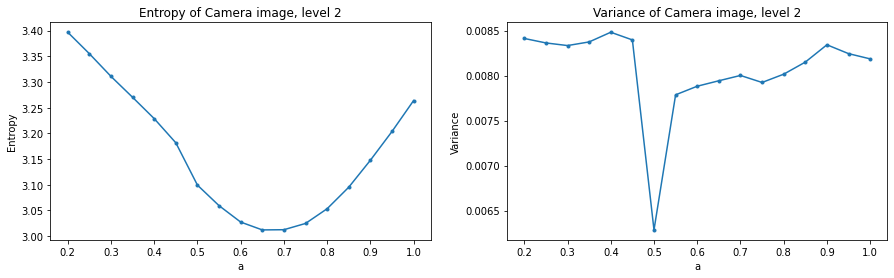

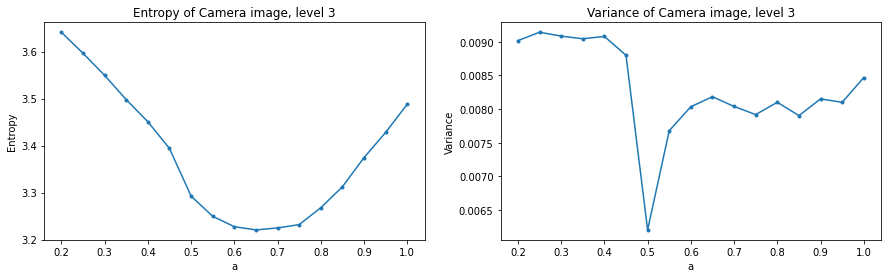

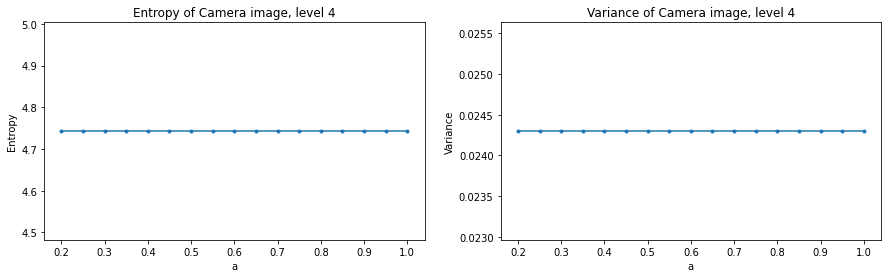

In [ ]:
[entropy_camera,variance_camera]=computeEntropyVarianceByLevel(Camera,5,"Camera")

Παρατηρούμε ότι η εντροπία ανά επίπεδο έχει αντίστοιχη κατανομή (εκτός του τελευαίου επιπεδου) και παρουσιάζει ελάχιστο στο διάστημα [0.6-0.7] όπως και ήταν αναμενόμενο. Η διακύμανση από την άλλη παρουσιάζει διαφοροποιήσεις στην κατανομή από επίπεδο σε επίπεδο ωστοσο στις περισσότερες περιπτώσεις το ελάχιστο βρίσκεται για α = 0.5.

Καθώς γύρω από το τοπικό ελάχιστο έχουμε ομαλή αύξηση/μείωση τόσο της εντροπίας όσο και της διακύμανσης, εκτιμούμε ότι ο υπολογισμός ενός μέσου όρου των τιμών του α που ελαχιστοποιουν την εντροπία και την διακύμανση σε κάθε επίπεδο, αποτελεί ένα ικανό κριτήριο για την επίτευξη τόσο χαμηλής εντροπίας όσο και διακύμανσης στο σύνολο της πυραμίδας.

In [ ]:
#A function to compute histogram for a specific pyramid level
def computeHistDepthLevel(LaplacianPyramid,level):  
    histByLevel = []
    hist = cv2.calcHist(np.float32([LaplacianPyramid[level]]), [0], None, [256], [0, 256])        #compute histogram for a specific level
    return hist

#A function to compute Laplacian pyramid and histogram for a specific level
def calcHistLevel (Image,a,depth,level):    
    LaplacianPyramid=LPyramid(Image,a,depth)                                                      #compute Laplacian pyramid
    hist_by_level = computeHistDepthLevel(LaplacianPyramid,level)                                 #compute histogram for a specific level
    return hist_by_level

#A function to compute best a
def HistogramsLevel(Image,depth):  
    entropyarr=[]
    variancearr=[]
    for j in range (depth):                                                                       #for each level of the pyramid
      min_entropy = 100
      min_variance = 100
      for i in range (2,8):                                                                       #for each a
            i=i/10
            histbylevel=calcHistLevel(Image,i,depth,j)                                            #compute histogram for level j 
            entropy=(st.entropy(histbylevel/histbylevel.max())[0])                                #compute entropy of normalised histogram for level j
            variance=np.var(histbylevel/histbylevel.max())                                        #compute variance of normalised histogram for level j
            if (entropy < min_entropy):                                                           #we keep the minimum entropy
              entropymin=i
              min_entropy=entropy
            if (variance < min_variance):                                                         #we keep the minimum variance
              variancemin=i
              min_variance=variance  
      entropyarr.append(entropymin)                                                         
      variancearr.append(variancemin)
    a=(np.mean(entropyarr)+np.mean(variancearr))/2                                                #best a is computed by a = (mean(minimum entropy)+mean(minimum variance))/2
    return a

Για την ασπρόμαυρη εικόνα Lena grayscale:

In [ ]:
min_a_lena_gray=HistogramsLevel(Lena_gray,5)
print("Best a for Lena grayscale : "+str(min_a_lena_gray))

Best a for Lena grayscale : 0.52


Για την έγχρωμη εικόνα Lena RGB:

In [ ]:
min_a_lena_rgb=HistogramsLevel(Lena_RGB,5)
print("Best a for Lena RGB : "+str(min_a_lena_rgb))

Best a for Lena RGB : 0.53


Για την εικόνα Camera:

In [ ]:
min_a_camera=HistogramsLevel(Camera,5)
print("Best a for camera : "+str(min_a_camera))

Best a for camera : 0.52


Όπως ειναι λογικό, επειδή οι φωτογραφίες είναι διαφορετικές έχουν διαφορετικό βέλτιστο α το οποίο πράγματι ανήκει σο διάστημα [0.5-0.7] όπως αναμέναμε με βάση τα διαγράμματα.

**Ερώτημα στ):**

Σε αυτό το ερώτημα υλοποιήσαμε τρεις υποσυναρτήσεις κβαντισμού για τρία διαφορετικά πειράματα. Με βάση το paper γνωρίζουμε ότι σε μεγαλύτερα επίπεδα στην πυραμίδα θα πρέπει να έχουμε μικρότερο bin size, καθώς η ευαισθησία του ανθρώπου σε σφάλματα στην πληροφορία που κωδικοποιείται σε αυτά είναι μεγαλύτερη.

Προτεινόμενη μέθοδος για την επιλογή του μεγέθους bin για κάθε επίπεδο για την κβάντιση είναι σύμφωνα με το δοσμένο άρθρο η τιμή εκείνη για την οποία μόλις αρχίζει να φαίνεται η υποβάθμιση της ποιότητας σε σχέση με την μη κβαντισμένη εικόνα γι αυτό το επίπεδο, για απόσταση παρατηρητή ίση με πέντε φορές το πλάτος της εικόνας.
Επιλέγουμε την εκτέλεση τριών πειραμάτων, προκειμένου να εξετάσουμε την παραπάνω προτεινόμενη μέθοδο: Στο πρώτο πείραμα επιλέγουμε bin size για κάθε επίπεδο ώστε να είναι μόλις εμφανής η οπτική υποβάθμιση σε κάθε επίπεδο. Στο δεύτερο πείραμα επιλέγουμε bin size ώστε να είναι πιο έντονη η οπτική υποβάθμιση ανά επίπεδο αλλά να έχουμε λιγότερα επίπεδα κβάντισης και άρα λιγότερα απαιτούμενα bits ανά pixel. Στο τρίτο πείραμα επιλέγουμε bin size τέτοιο ώστε τα επίπεδα κβάντισης να είναι περισσότερα και η οπτική υποβάθμιση να μην είναι εμφανής.

In [ ]:
#A function to compute quantized pyramid for the first experiment
def firstExp(pyramid):
    quantized_lap=[]
    bin_sizes=len(pyramid) 
    bins=[14,23,40,45,48]                                                                #bin sizes for the first experiment
    for i in range (0, bin_sizes):    
        image_quantized=L_Quantization(pyramid[i],bins[i])                               #compute quantized pyramid
        quantized_lap.append(image_quantized)  
    return quantized_lap

In [ ]:
#A function to compute quantized pyramid for the second experiment
def secondExp(pyramid):
    quantized_lap=[]
    bin_sizes=len(pyramid)  
    bins=[8,14,22,26,27]                                                                 #bin sizes for the second experiment
    for i in range (0, bin_sizes):    
        image_quantized=L_Quantization(pyramid[i],bins[i])                               #compute quantized pyramid
        quantized_lap.append(image_quantized)  
    return quantized_lap

In [ ]:
#A function to compute quantized pyramid for the third experiment
def thirdExp(pyramid):
    quantized_lap=[]
    bin_sizes=len(pyramid) 
    bins=[25,40,58,64,65]                                                                #bin sizes for the third experiment
    for i in range (0, bin_sizes):    
        image_quantized=L_Quantization(pyramid[i],bins[i])                               #compute quantized pyramid
        quantized_lap.append(image_quantized)  
    return quantized_lap

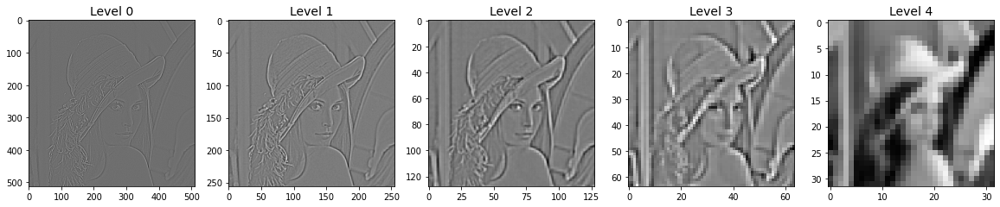

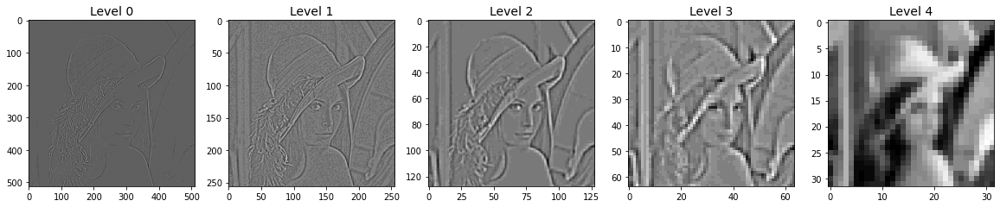

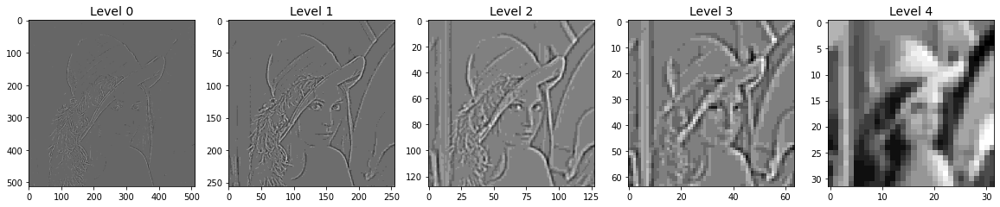

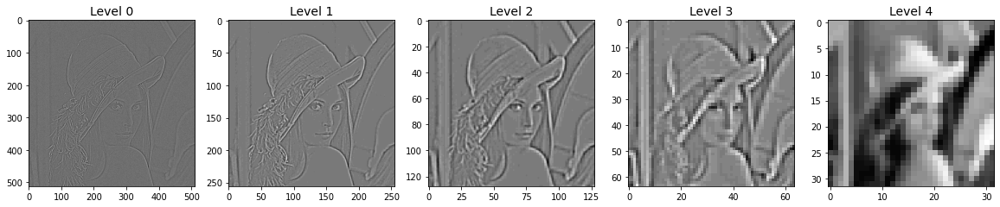

In [ ]:
#orginal pyramid
Lena_gray_lap=LPyramid(Lena_gray,0.52,5)
showPyramid(Lena_gray_lap, 'gray')

#first experiement
Lena_gray_lap_quant_first=firstExp(Lena_gray_lap)
showPyramid(Lena_gray_lap_quant_first, 'gray')

#second experiement
Lena_gray_lap_quant_second=secondExp(Lena_gray_lap)
showPyramid(Lena_gray_lap_quant_second, 'gray')

#third experiement
Lena_gray_lap_quant_third=thirdExp(Lena_gray_lap)
showPyramid(Lena_gray_lap_quant_third, 'gray')

Στην συνέχεια δείχνουμε την αρχική εικόνα μαζί με κάθε reconstructed εικόνα που προέκυψε μετά απο αποκωδικοποίηση των παραπάνω εικόνων προκειμένου να υπάρχει οπτική σύγκριση:

In [ ]:
#A function to show reconstructed image next to the original image
def showExperimentsDecoded(original,quant_f,quant_s,quant_t,a,type):
    quantized=[quant_f,quant_s,quant_t]                                                         #takes as input the quantized image of the three experiments
    exp=["first","second","third"]
    Decoded=[]
    for i in range (3):
        Decoded.append(L_Pyramid_Decode(quantized[i],a))                                        #decode each quantized image
        f1, (ax0,ax1)= plt.subplots(1, 2, figsize=(10, 10))
        if (type=="gray"):                                                                      #if image is grayscale
            ax0.imshow(Decoded[i], cmap="gray")                                                 #plot reconstructed image
            ax0.set_title('Reconstructed from '+str(exp[i])+" experiment", fontsize=10)
            ax1.imshow(original, cmap="gray")                                                   #plot original image
            ax1.set_title('Original', fontsize=10)
        else:                                                                                   #if image is RGB
            ax0.imshow(Decoded[i].astype(int))                                                  #plot reconstructed image
            ax0.set_title('Reconstructed', fontsize=14)
            ax1.imshow(original)                                                                #plot original image
            ax1.set_title('Original', fontsize=14)
    return Decoded

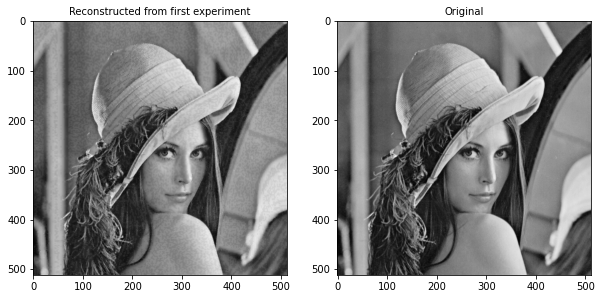

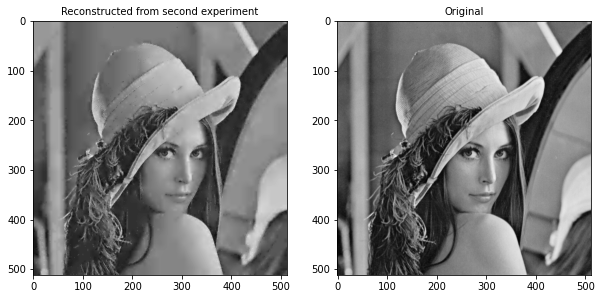

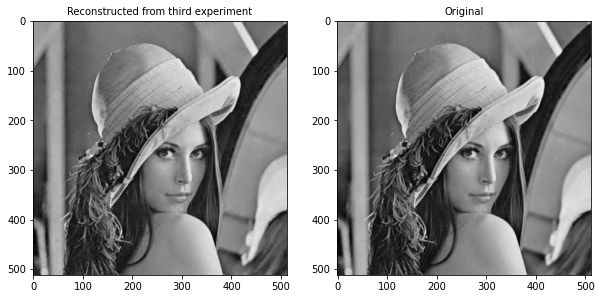

In [ ]:
Lena_gray_decoded=showExperimentsDecoded(Lena_gray,Lena_gray_lap_quant_first,Lena_gray_lap_quant_second,Lena_gray_lap_quant_third,0.52,'gray')

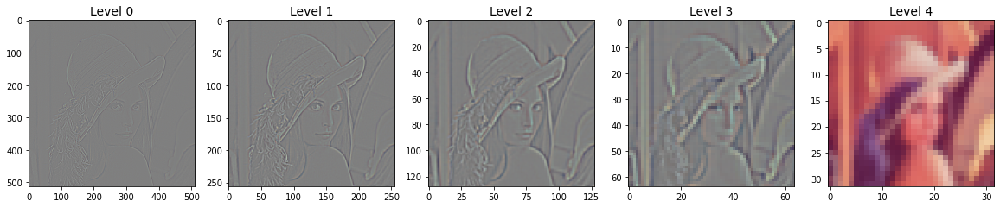

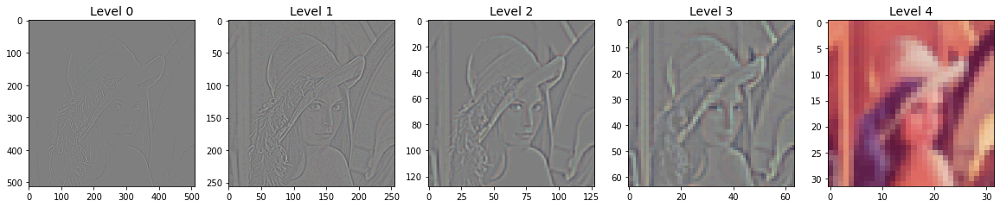

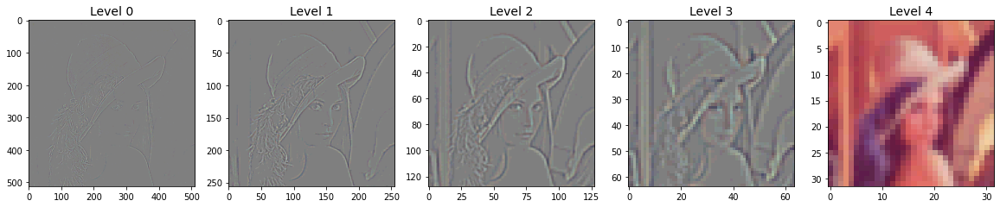

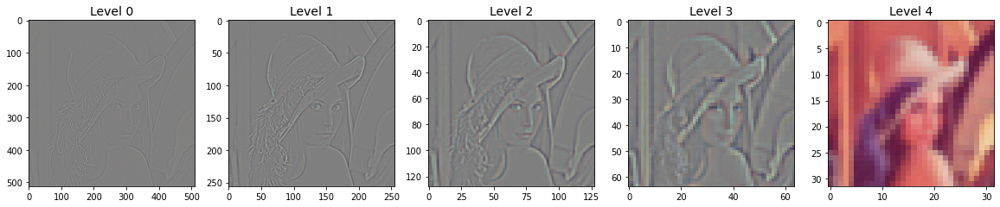

In [ ]:
Lena_rgb_lap=LPyramid(Lena_RGB,0.53,5)
showPyramid(Lena_rgb_lap, 'RGB')

Lena_rgb_lap_quant_first=firstExp(Lena_rgb_lap)
showPyramid(Lena_rgb_lap_quant_first, 'RGB')

Lena_rgb_lap_quant_second=secondExp(Lena_rgb_lap)
showPyramid(Lena_rgb_lap_quant_second, 'RGB')

Lena_rgb_lap_quant_third=thirdExp(Lena_rgb_lap)
showPyramid(Lena_rgb_lap_quant_third, 'RGB')


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


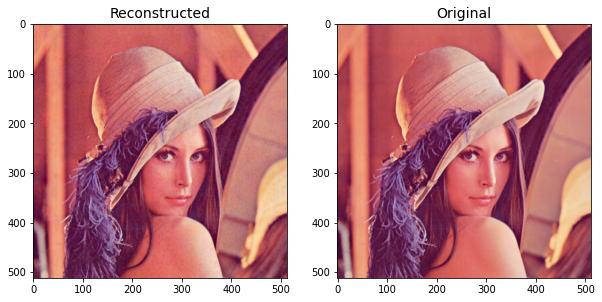

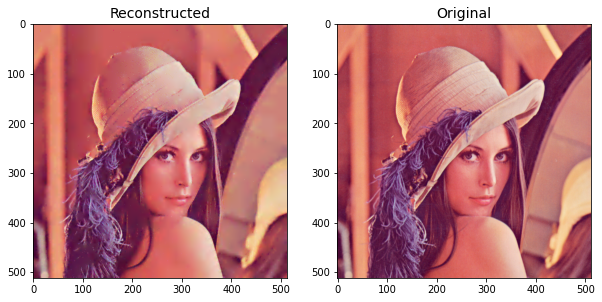

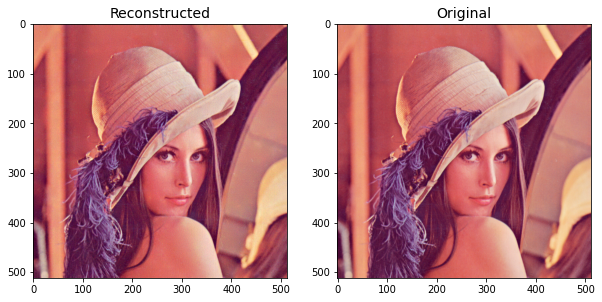

In [ ]:
Lena_rgb_decoded=showExperimentsDecoded(Lena_RGB,Lena_rgb_lap_quant_first,Lena_rgb_lap_quant_second,Lena_rgb_lap_quant_third,0.53,'rgb')

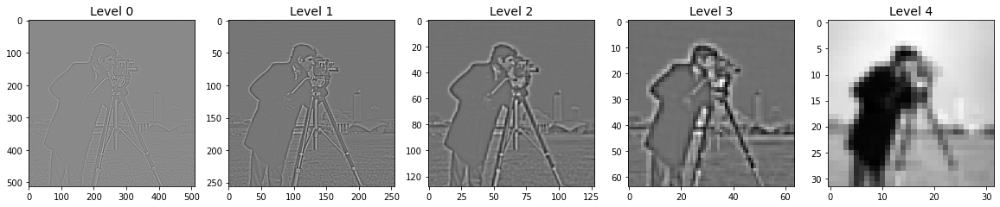

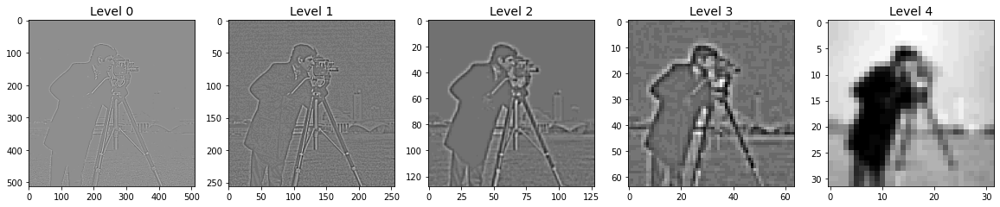

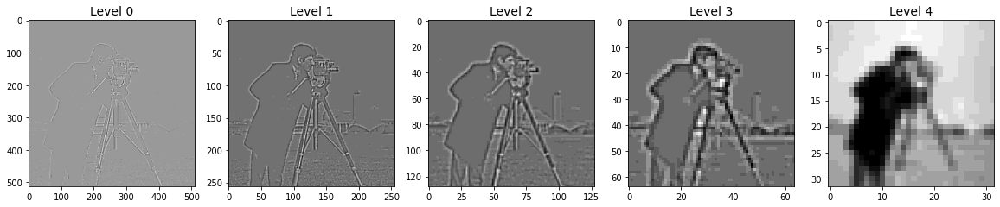

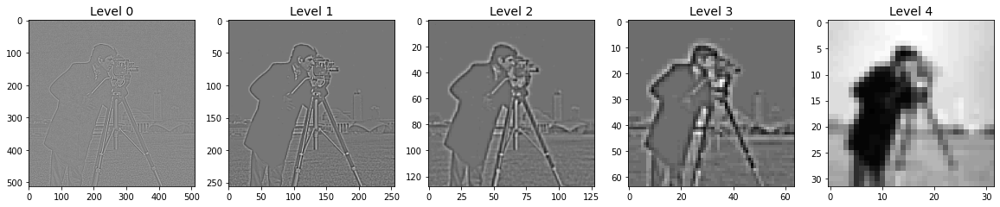

In [ ]:
Camera_gray_lap=LPyramid(Camera,0.52,5)
showPyramid(Camera_gray_lap, 'gray')

Camera_gray_lap_quant_first=firstExp(Camera_gray_lap)
showPyramid(Camera_gray_lap_quant_first, 'gray')

Camera_gray_lap_quant_second=secondExp(Camera_gray_lap)
showPyramid(Camera_gray_lap_quant_second, 'gray')

Camera_gray_lap_quant_third=thirdExp(Camera_gray_lap)
showPyramid(Camera_gray_lap_quant_third, 'gray')


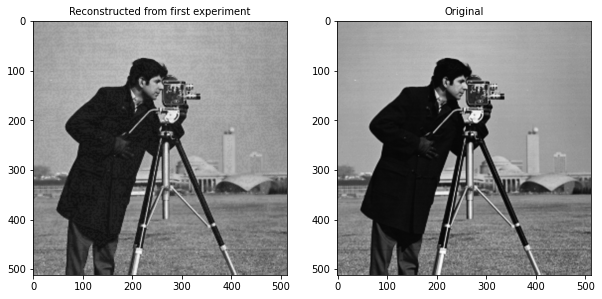

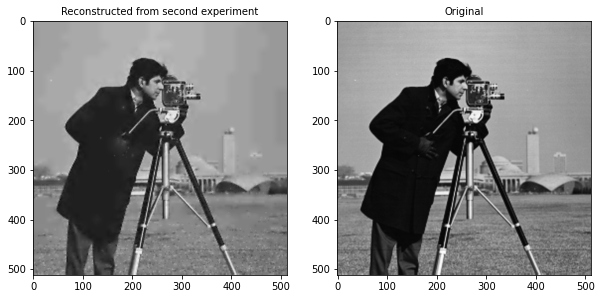

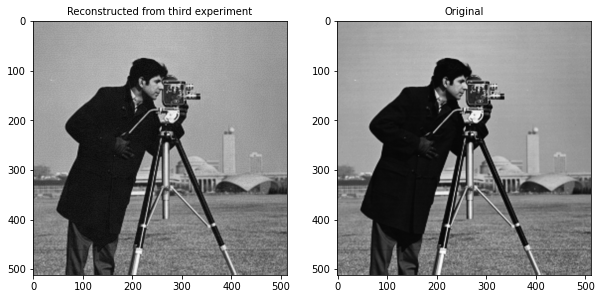

In [ ]:
Camera_decoded=showExperimentsDecoded(Camera,Camera_gray_lap_quant_first,Camera_gray_lap_quant_second,Camera_gray_lap_quant_third,0.52,'gray')

Τα παραπάνω πειράματα έχουν τα εξής αποτελέσματα: 

*  Το πρώτο πείραμα, όπου το bin size είναι τέτοιο σε κάθε επίπεδο ώστε να είναι μόλις διακριτή η οτική διαφοροποίηση, οδηγεί σε ανακατασκευασμένες εικόνες οι οποίες έχουν αρκετά καλή ποιότητα σε σχέση με την αρχική, με όλες τις λεπτομέρειες και τα χαρακτηρηστικά της εικόνας (π.χ. ακμές) να είναι εμφανή, ωστόσο παρατηρείται στην ανακατασευασμένη εκδοχή μία ήπιο υποβάθμιση στο χρώμα. 
*   Στο δεύτερο πείραμα, όπου έχει επιλεγεί αρκετά μεγαλύτερο bin size σε κάθε επίπεδο, το οπτικό αποτέλεσμα της ανακατασευασκμένης εικόνας είναι υποδεέστερο, με την εικόνα να εμφανίζεται πιο θολή και ιδιαίτερα όσον αφορά τις ακμές της εικόνας, όπως άλλωστε ήταν αναμενόμενο λόγω της εντονότερης κβάντισης.
*  Στο τρίτο πείραμα, καθώς το bin size που επιλέχθηκε ήταν μικρότερο σε σχέση με τα δύο προηγούμενα πειράματα, το οπτικό αποτέλεσμα είναι πολύ καλύτερο: Η ποιότητα της ανακατασεκυασμένης εικόνας είναι συγκρίσιμη με την αρχική. 

Επισημαίνουμε ότι, σε όλες τις περιπτώσεις (ιδιαίτερα για το πρώτο και τρίτο πείραμα), η ανακατασευασμένη εικόνα έχει αρκετά καλή ποιότητα, γεγονός που αποτελεί σημαντικό όφελος της μεθόδου της Λαπλασιανής πυραμίδας, καθώς μας επιτρέπεται η εντονότερη κβάντιση και άρα μείωση τoυ αριθμού bits ανά pixel, με παράλληλη διατήρηση της ποιότητας της εικόνας.



**Ερώτημα ζ):**

Σε αυτό το ερώτημα μας ζητήθηκε να υπολογίσουμε το SNR  των ανακατασκευασμένων εικόνων με χρήση της αρχικής εικόνας για κάθε ένα από τα 3 πειράματα.
Πιο συγκεκριμένα, χρησιμοποιήσαμε το PSNR καθώς αποτελεί ένα είδος σύγκρισης της ποιότητας της ανακατασκευασμένης εικόνας σε σχέση με την αρχική και άρα μας επιτρέπει να διακρίνουμε τις συνέπειες της κβάντισης στην ποιότητα εικόνας.

In [ ]:
import math

#A function to compute PSNR of the reconstructed image
def PSNR(reconstructed, initial):
  mse = np.mean(( reconstructed.astype(np.float64) / 255. - initial.astype(np.float64) / 255.) ** 2)          #compute mean value of the reconstructed image 
  if mse == 0:
    psnr=0
  else:
    psnr=10 * math.log10(1. / mse)                                                                            #compute PSNR
  return psnr

Για την εικόνα Lena grayscale:

In [ ]:
#first experiment 

psnr=PSNR(np.asarray(Lena_gray_decoded[0]),Lena_gray)
print("PSNR of reconstructed Lena grayscale for the first experiment is: ", psnr)

#second experiment 

psnr=PSNR(np.asarray(Lena_gray_decoded[1]),Lena_gray)
print("PSNR of reconstructed Lena grayscale for the second experiment is: ", psnr)

#third experiment 

psnr=PSNR(np.asarray(Lena_gray_decoded[2]),Lena_gray)
print("PSNR of reconstructed Lena grayscale for the third experiment is: ", psnr)

PSNR of reconstructed Lena grayscale for the first experiment is:  34.011521387962624
PSNR of reconstructed Lena grayscale for the second experiment is:  31.36827735757298
PSNR of reconstructed Lena grayscale for the third experiment is:  36.281125018127966


Για την εικόνα Lena RGB:

In [ ]:
#first experiment 

psnr=PSNR(np.asarray(Lena_rgb_decoded[0]),Lena_RGB)
print("PSNR of reconstructed Lena with color for the first experiment is: ", psnr)

#second experiment 

psnr=PSNR(np.asarray(Lena_rgb_decoded[1]),Lena_RGB)
print("PSNR of reconstructed Lena with color for the second experiment is: ", psnr)

#third experiment 

psnr=PSNR(np.asarray(Lena_rgb_decoded[2]),Lena_RGB)
print("PSNR of reconstructed Lena with color for the third experiment is: ", psnr)

PSNR of reconstructed Lena with color for the first experiment is:  33.5645606399958
PSNR of reconstructed Lena with color for the second experiment is:  30.683048115740146
PSNR of reconstructed Lena with color for the third experiment is:  36.583829487163165


Για την εικόνα Camera:

In [ ]:
#first experiment 

psnr=PSNR(np.asarray(Camera_decoded[0]),Camera)
print("PSNR of reconstructed Camera for the first experiment is: ", psnr)

#second experiment 

psnr=PSNR(np.asarray(Camera_decoded[1]),Camera)
print("PSNR of reconstructed Camera for the second experiment is: ", psnr)

#third experiment 

psnr=PSNR(np.asarray(Camera_decoded[2]),Camera)
print("PSNR of reconstructed Camera for the third experiment is: ", psnr)

PSNR of reconstructed Camera for the first experiment is:  34.376110218529064
PSNR of reconstructed Camera for the second experiment is:  32.127874071881365
PSNR of reconstructed Camera for the third experiment is:  35.421485553102976


Με βάση τα παραπάνω παρατηρούμε ότι αντίστοιχα με το οπτικό αποτέλεσμα του ερωτήματος (στ), το δεύτερο πείραμα έχει το χαμηλότερο PSNR το οποίο ήταν αναμενόμενο, καθώς χρησιμοποιήσαμε μεγαλύτερο bin size και άρα λιγότερα επίπεδα κβάντισης. Αντίστοιχα, το τρίτο πείραμα παρουσιάζει το μεγαλύτερο PSNR, αφού έχει περισσότερα επίπεδα κβάντισης επομένως και μεγαλύτερη ακρίβεια σε σχέση με την αρχική εικόνα. Τέλος, το πρώτο πείραμα παρουσιάζει μεσαία τιμή PSNR σε σχέση με τα υπόλοιπα δύο κάτι το οποίο αναμέναμε με βάση τις τιμές των bin sizes. Και στις τρεις πάτνως περιπτώσεις, το PSNR έχει μία αρκετά ψηλή τιμή δεδομένο

Τα παραπάνω συμπεράσματα επιβεβαιώνουν την ύπαρξη ενος tradeoff μεταξύ του αριθμού των bits ανά pixel τα οποία απαιτούνται για την αναπαράσταση μίας εικόνας και της ποιότητας της ανακατασκευασμένης εικόνας σε σχέση με την αρχική. 